In [1]:
import scanpy as sc
import os
import numpy as np
import seaborn
import matplotlib
import pandas as pd
import sys
import scipy
import tqdm
import matplotlib.pyplot as plt

sys.path.append('/home/matthew.schmitz/utils/mts-utils/')
from genomics import sc_analysis
# sys.path.append('/home/matthew.schmitz/Matthew/code/scANTIPODE/')
import antipode
import antipode.antipode_model
import antipode.model_functions
import antipode.model_distributions
import antipode.model_modules
import antipode.train_utils
import antipode.plotting


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
adata=sc.read_h5ad('/home/matthew.schmitz/Matthew/models/1.9.1.8.3_Dev/p4_adata.h5ad',backed='r')

In [3]:
MDE_KEY='X_antipode_MDE'

# LaManno Labels

In [4]:
linnarson_labels=pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/extra/mousefastqpool/SRP135960_linnarson_adultmouse/annotations/unambiguous_metadata_renamed.csv',index_col=0)

In [5]:
linnarson_labels=linnarson_labels.loc[linnarson_labels.index.isin(adata.obs.index),:]

In [6]:
linnarson_labels

,n_genes,batch_name,dataset_name,timepoint,region,clean_cellname,full_cellname,msregion,general_region,species,...,Split,Strain,Subclass,Target_Num_Cells,Tissue,TotalUMI,Transcriptome,cDNA_Lib_Ok,ngperul_cDNA,barcode
original_index,,,,,,,,,,,,,,,,,,,,,
GATCCCTGTTGGTG_e10.0_Forebrain_SRR11947585-0,5583,e10.0_Forebrain_SRR11947585,PRJNA637987_lamanno_devmouse,10,FB,GATCCCTGTTGGTG,GATCCCTGTTGGTG_e10.0_Forebrain_SRR11947585,NaN,h,mouse,...,0,CD-1,Forebrain,3500.0,Forebrain,37523.0,mm10,Y,"10,0",GATCCCTGTTGGTG
TGCAATCTTCCGAA_e10.0_Forebrain_SRR11947585-0,3597,e10.0_Forebrain_SRR11947585,PRJNA637987_lamanno_devmouse,10,FB,TGCAATCTTCCGAA,TGCAATCTTCCGAA_e10.0_Forebrain_SRR11947585,NaN,h,mouse,...,0,CD-1,Erythroid progenitor,3500.0,Forebrain,36939.0,mm10,Y,"10,0",TGCAATCTTCCGAA
GACGTAACGATAAG_e10.0_Forebrain_SRR11947585-0,5416,e10.0_Forebrain_SRR11947585,PRJNA637987_lamanno_devmouse,10,FB,GACGTAACGATAAG,GACGTAACGATAAG_e10.0_Forebrain_SRR11947585,NaN,h,mouse,...,0,CD-1,Forebrain,3500.0,Forebrain,34992.0,mm10,Y,"10,0",GACGTAACGATAAG
ACATCACTACGCAT_e10.0_Forebrain_SRR11947585-0,3754,e10.0_Forebrain_SRR11947585,PRJNA637987_lamanno_devmouse,10,FB,ACATCACTACGCAT,ACATCACTACGCAT_e10.0_Forebrain_SRR11947585,NaN,h,mouse,...,0,CD-1,Erythroid progenitor,3500.0,Forebrain,36677.0,mm10,Y,"10,0",ACATCACTACGCAT
ATAAGTTGAACGAA_e10.0_Forebrain_SRR11947585-0,2921,e10.0_Forebrain_SRR11947585,PRJNA637987_lamanno_devmouse,10,FB,ATAAGTTGAACGAA,ATAAGTTGAACGAA_e10.0_Forebrain_SRR11947585,NaN,h,mouse,...,0,CD-1,Erythroid progenitor,3500.0,Forebrain,36413.0,mm10,Y,"10,0",ATAAGTTGAACGAA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ATCACTTGTGGGAG_e18.0_ForebrainVentroLateral_SRR11947657-0,856,e18.0_ForebrainVentroLateral_SRR11947657,PRJNA637987_lamanno_devmouse,18,FB,ATCACTTGTGGGAG,ATCACTTGTGGGAG_e18.0_ForebrainVentroLateral_SR...,NaN,h,mouse,...,1,CD-1,Mixed region glutamatergic,3500.0,Midbrain,8062.0,mm10,Y,"4,0",ATCACTTGTGGGAG
ATTCGGGAACGGTT_e18.0_ForebrainVentroLateral_SRR11947657-0,804,e18.0_ForebrainVentroLateral_SRR11947657,PRJNA637987_lamanno_devmouse,18,FB,ATTCGGGAACGGTT,ATTCGGGAACGGTT_e18.0_ForebrainVentroLateral_SR...,NaN,h,mouse,...,0,CD-1,Oligodendrocyte precursor cell,3500.0,ForebrainVentroLateral,3272.0,mm10,Y,"4,8",ATTCGGGAACGGTT
ATGCAGACGGATTC_e18.0_ForebrainVentroLateral_SRR11947657-0,924,e18.0_ForebrainVentroLateral_SRR11947657,PRJNA637987_lamanno_devmouse,18,FB,ATGCAGACGGATTC,ATGCAGACGGATTC_e18.0_ForebrainVentroLateral_SR...,NaN,h,mouse,...,1,CD-1,Mixed region and neurotransmitter,3500.0,Midbrain,11987.0,mm10,Y,"4,0",ATGCAGACGGATTC


In [7]:
cols=["Class","Subclass","ClusterName"]#linnarson_labels.columns[~linnarson_labels.columns.isin(adata.obs.columns)]
adata.obs.loc[linnarson_labels.index,cols]=linnarson_labels.loc[:,cols]

In [8]:
linnarson_labels['Class'].value_counts()

Class
Neuron                        99881
Neuroblast                    42571
Radial glia                   36772
Glioblast                     12206
Gastrulation                  11072
Bad cells                      8985
Mesenchyme                     7330
Fibroblast                     7183
Vascular                       6404
Ectoderm                       3494
Immune                         3369
Neural tube                    2888
Blood                          2449
Oligodendrocyte                2007
Neural crest                   1316
Mesoderm                       1287
Choroid plexus                  741
Schwann cell                    599
Endoderm                        370
Ependymal                       344
Olfactory ensheathing cell      270
Undefined                       144
Subcommissural organ            107
Pineal gland                    100
Name: count, dtype: int64

In [9]:
linnarson_labels['Subclass'].value_counts()

Subclass
Cortical or hippocampal glutamatergic    24410
Forebrain GABAergic                      20219
Midbrain glutamatergic                   14137
Undefined                                12837
Forebrain glutamatergic                  12391
                                         ...  
Arachnoid barrier cells                     15
Late isthmic organizer                      14
Pituitary neuroendocrine                    12
Parietal endoderm                           11
Olfactory epithelium                        10
Name: count, Length: 133, dtype: int64

In [10]:
adata.obs

,n_genes,batch_name,dataset_name,timepoint,region,clean_cellname,full_cellname,msregion,general_region,species,...,psi_1,psi_2,q_score,level_0,level_1,level_2,antipode_cluster,Class,Subclass,ClusterName
TCAGACGCACTT_e14-WT8-1-0,3018,e14-WT8-1,GSE123335_cortex,14,Ctx,TCAGACGCACTT,TCAGACGCACTT_e14-WT8-1,nan,ctx,mouse,...,0.017200,-0.016581,0.288225,0,46,141,0_46_141,NaN,NaN,NaN
GTAGCTGGCTTT_e14-WT8-1-0,2968,e14-WT8-1,GSE123335_cortex,14,Ctx,GTAGCTGGCTTT,GTAGCTGGCTTT_e14-WT8-1,nan,ctx,mouse,...,0.015540,-0.018635,0.285216,0,46,141,0_46_141,NaN,NaN,NaN
TAGTATGTAATA_e14-WT8-1-0,4312,e14-WT8-1,GSE123335_cortex,14,Ctx,TAGTATGTAATA,TAGTATGTAATA_e14-WT8-1,nan,ctx,mouse,...,0.026347,0.019404,0.587608,0,18,188,0_18_188,NaN,NaN,NaN
TTCGCATAGGTT_e14-WT8-1-0,2116,e14-WT8-1,GSE123335_cortex,14,Ctx,TTCGCATAGGTT,TTCGCATAGGTT_e14-WT8-1,nan,ctx,mouse,...,0.034448,-0.000781,0.142433,0,24,286,0_24_286,NaN,NaN,NaN
CCTCCAATTGGC_e14-WT8-1-0,3953,e14-WT8-1,GSE123335_cortex,14,Ctx,CCTCCAATTGGC,CCTCCAATTGGC_e14-WT8-1,nan,ctx,mouse,...,0.019429,0.010754,0.383024,0,9,29,0_9_29,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTTCCCTTGTG_SRR13565274_GSM5047783_GW21-04_cerebellum_Homo_sapiens_RNA-Seq_kOut,2133,SRR13565274_GSM5047783_GW21-04_cerebellum_Homo...,10.1038/s41467-023-43568-6,133,Cb,TTTGGTTTCCCTTGTG,TTTGGTTTCCCTTGTG_SRR13565274_GSM5047783_GW21-0...,nan,hb,human,...,0.017009,-0.025760,0.703241,0,1,52,0_1_52,NaN,NaN,NaN
TTTGGTTTCTGCGGCA_SRR13565274_GSM5047783_GW21-04_cerebellum_Homo_sapiens_RNA-Seq_kOut,1463,SRR13565274_GSM5047783_GW21-04_cerebellum_Homo...,10.1038/s41467-023-43568-6,133,Cb,TTTGGTTTCTGCGGCA,TTTGGTTTCTGCGGCA_SRR13565274_GSM5047783_GW21-0...,nan,hb,human,...,0.019477,0.010454,0.429872,0,23,68,0_23_68,NaN,NaN,NaN
TTTGTCACAGACGCAA_SRR13565274_GSM5047783_GW21-04_cerebellum_Homo_sapiens_RNA-Seq_kOut,869,SRR13565274_GSM5047783_GW21-04_cerebellum_Homo...,10.1038/s41467-023-43568-6,133,Cb,TTTGTCACAGACGCAA,TTTGTCACAGACGCAA_SRR13565274_GSM5047783_GW21-0...,nan,hb,human,...,0.003521,0.009809,0.600598,0,23,187,0_23_187,NaN,NaN,NaN
TTTGTCACATAACCTG_SRR13565274_GSM5047783_GW21-04_cerebellum_Homo_sapiens_RNA-Seq_kOut,3550,SRR13565274_GSM5047783_GW21-04_cerebellum_Homo...,10.1038/s41467-023-43568-6,133,Cb,TTTGTCACATAACCTG,TTTGTCACATAACCTG_SRR13565274_GSM5047783_GW21-0...,nan,hb,human,...,0.001880,-0.038037,0.583228,0,28,45,0_28_45,NaN,NaN,NaN


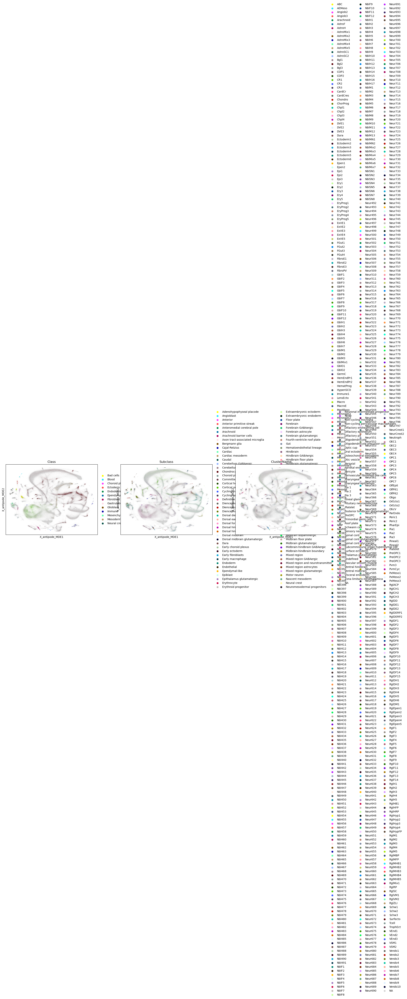

In [11]:
MDE_KEY='X_antipode_MDE'
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["Class","Subclass","ClusterName"],
    palette=sc.pl.palettes.godsnot_102
)


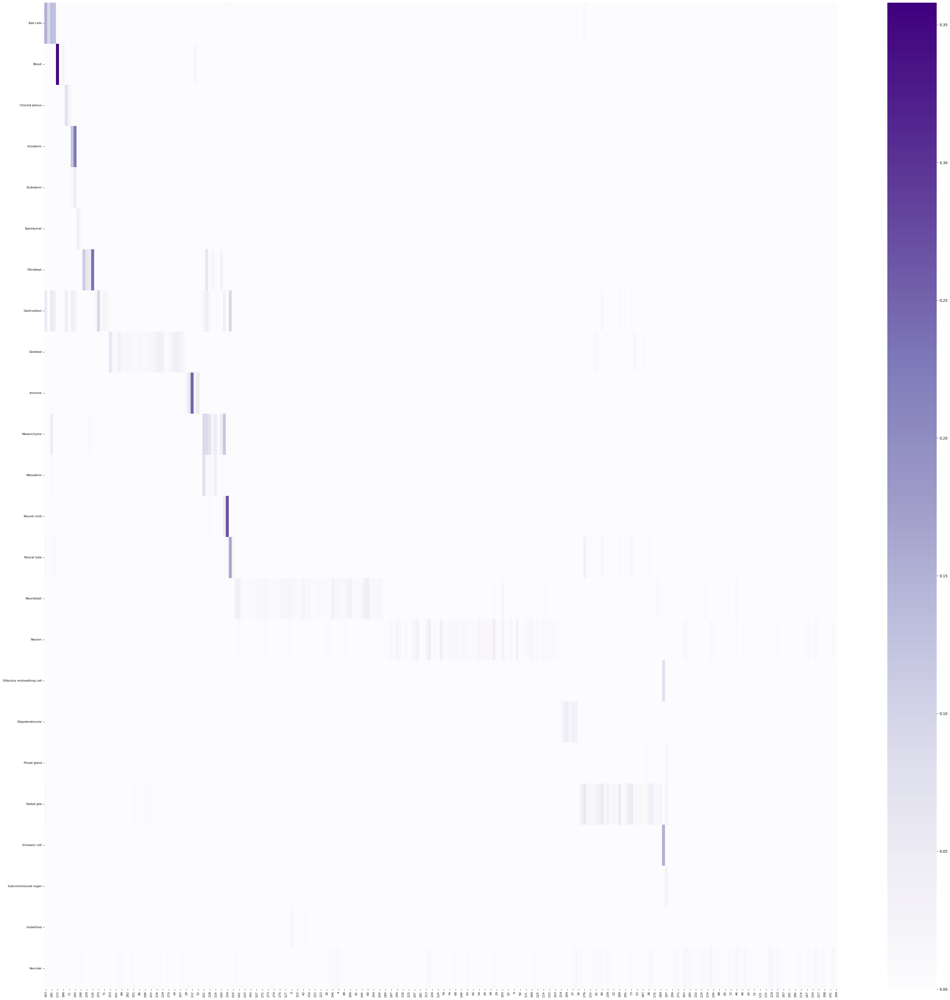

In [12]:
sc_analysis.create_heatmap(sc_analysis.get_cross_category_jaccard(adata.obs,'Class','level_2'),cmap='Purples')

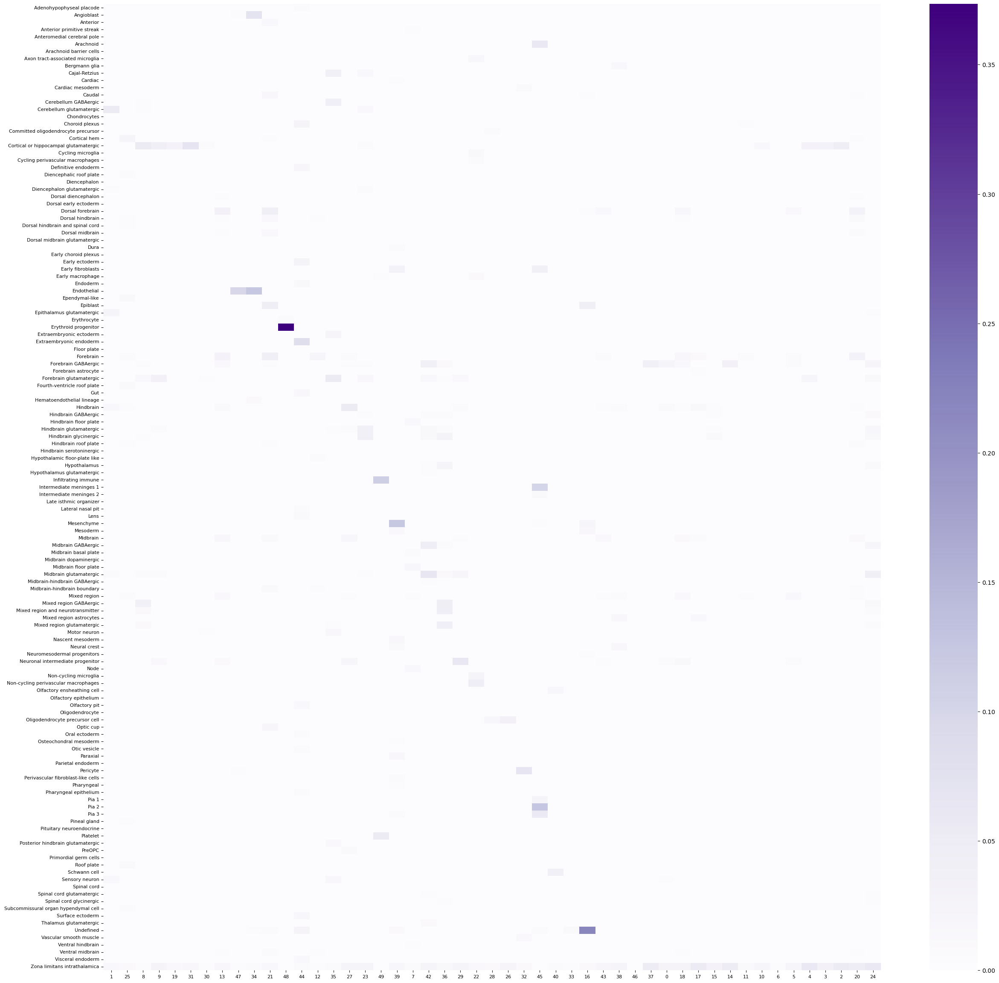

In [13]:
sc_analysis.create_heatmap(sc_analysis.get_cross_category_jaccard(adata.obs,'Subclass','level_1'),cmap='Purples')

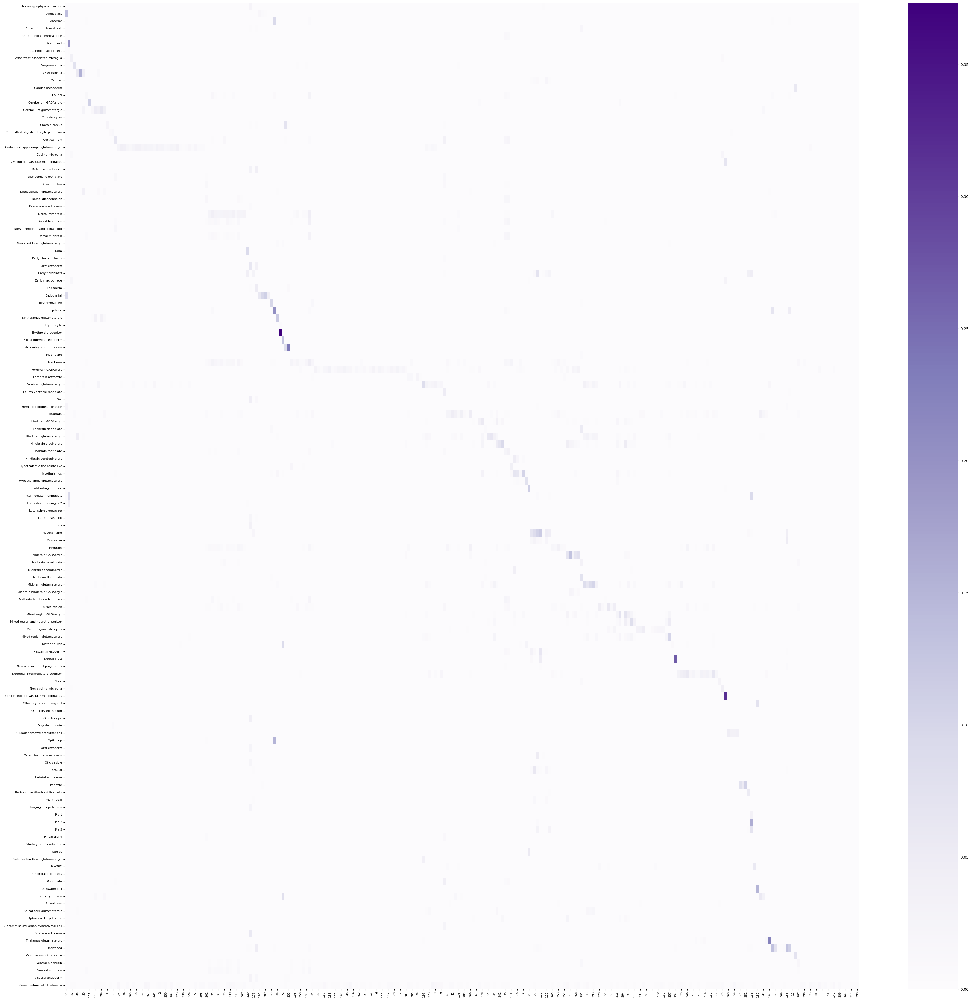

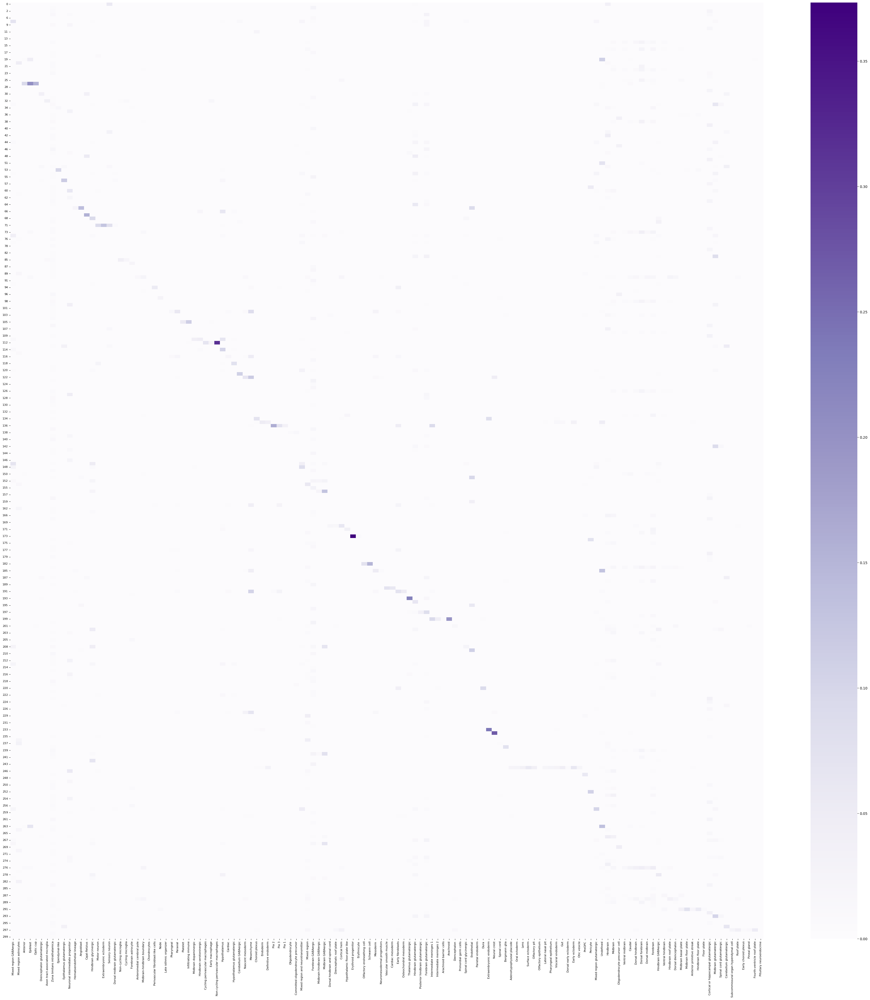

In [14]:
sc_analysis.create_heatmap(sc_analysis.get_cross_category_jaccard(adata.obs,'Subclass','level_2'),cmap='Purples')
sc_analysis.create_heatmap(sc_analysis.get_cross_category_jaccard(adata.obs,'level_2','Subclass'),cmap='Purples')

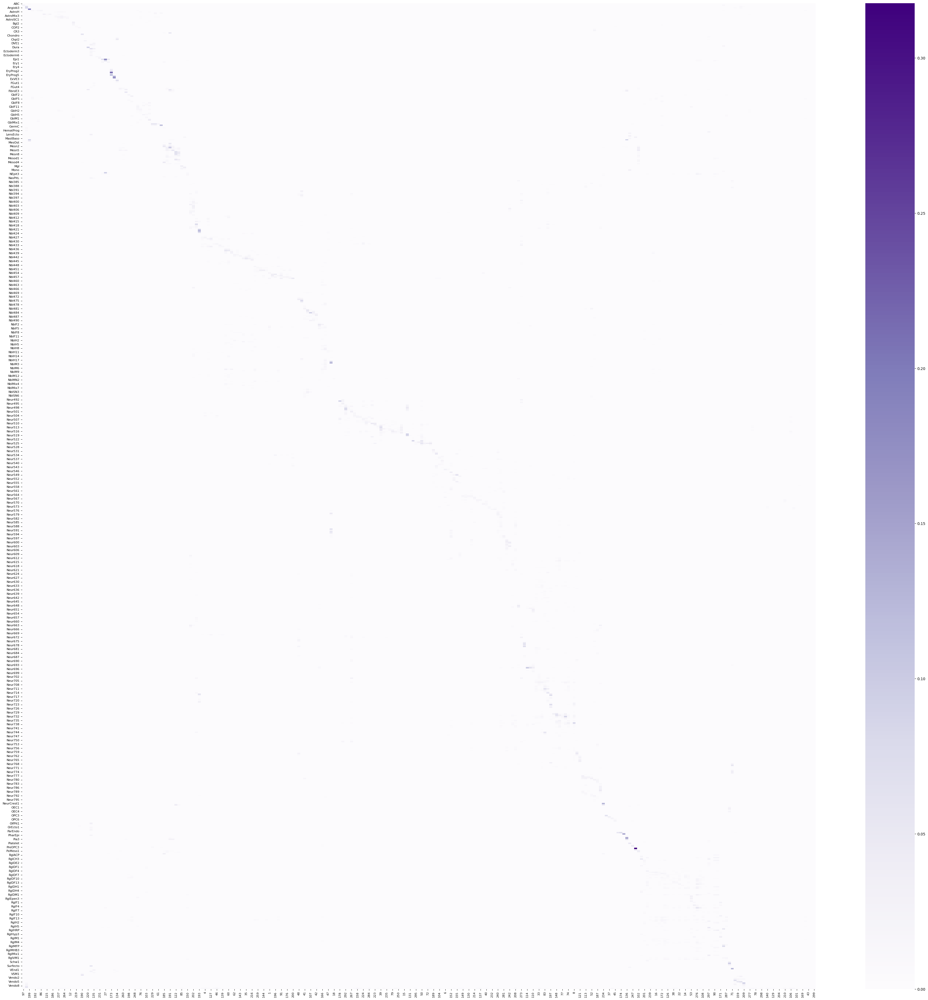

In [15]:
sc_analysis.create_heatmap(sc_analysis.get_cross_category_jaccard(adata.obs,'ClusterName','level_2'),cmap='Purples')

In [16]:
xcj=sc_analysis.get_cross_category_jaccard(adata.obs,'Subclass','level_2')

In [17]:
adata.obs['linnarson_extended']=adata.obs['level_2'].replace(adata.obs.groupby('level_2')['Subclass'].value_counts().unstack().idxmax(1).to_dict())

/scratch/fast/16874833/ipykernel_7510/2375379283.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs['linnarson_extended']=adata.obs['level_2'].replace(adata.obs.groupby('level_2')['Subclass'].value_counts().unstack().idxmax(1).to_dict())
/scratch/fast/16874833/ipykernel_7510/2375379283.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['linnarson_extended']=adata.obs['level_2'].replace(adata.obs.groupby('level_2')['Subclass'].value_counts().unstack().idxmax(1).to_dict())


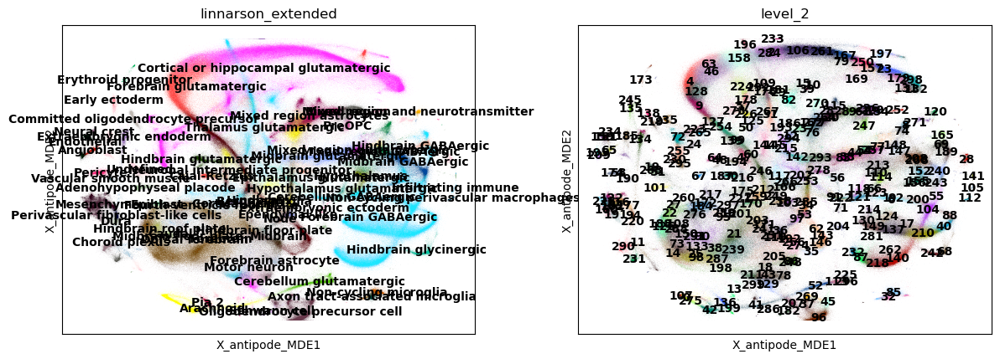

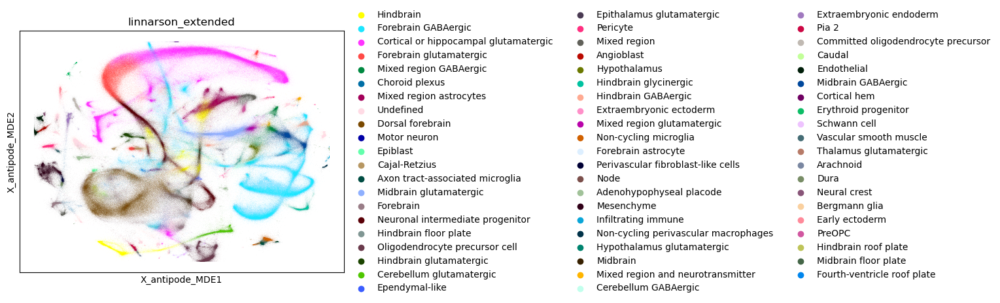

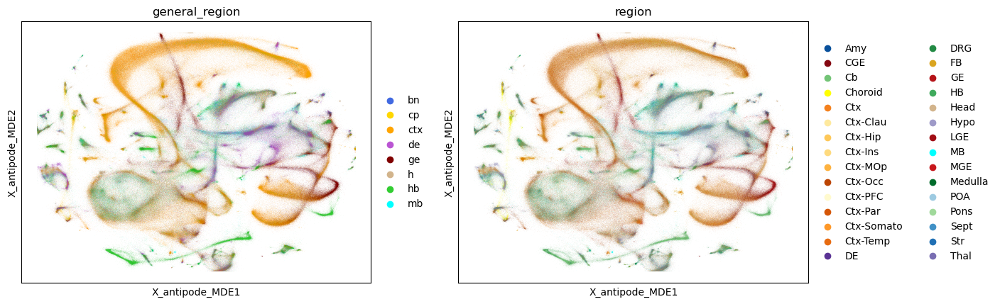

In [18]:
MDE_KEY='X_antipode_MDE'
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["linnarson_extended",'level_2'],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data'
)

sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["linnarson_extended"],
    palette=sc.pl.palettes.godsnot_102
)

sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["general_region",'region']
)


In [19]:
rpca_labels=pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/HvQvM/other_integrations/rpca_cell_annotations.txt',index_col=0)

In [20]:
adata.obs.index=adata.obs.index.to_series().str.replace('-[0-9]+$','',regex=True).str.replace('-[0-9]+$','',regex=True)
adata.obs_names_make_unique()

In [21]:
rpca_labels.columns=['rpca_class','rpca_leiden']

In [22]:
rpca_labels.loc[rpca_labels.index[rpca_labels.index.isin(adata.obs.index)],:]

,rpca_class,rpca_leiden
TAGGGACTGGTACT_e18.0_ForebrainVentroLateral_SRR11947657,Neuron,3
TAGTGGTGATCGAC_e8.0_Head_SRR11947592,Fibroblast,19
CGTACCTGCAGATC_e15.0_Hindbrain_SRR11947621,Neuron,26
GTACTTTCATACGCCG_E18_hypothalamus_SAMN11975086,Neuron,26
CTTCTCTTCGTGGTCG_E13_hypothalamus_SAMN11975092,Neuron,9
...,...,...
GGCTTGGCAGCACCCA_GW19_SS_v3_0_1_HM732DMXX_kOut,Neuron,10
GTGCAGCGTCACCTAA_GW10_hypothalamus_kOut,Neuron,22
TTCCCAGGTAGTGAAT_GW18_V1_kOut,Neuron,3
TGCGATATCCTTATCA_GW18_2_motorVZ_kOut,Neuron,6


In [23]:
adata.obs.loc[rpca_labels.index[rpca_labels.index.isin(adata.obs.index)],['rpca_class','rpca_leiden']]=rpca_labels.loc[rpca_labels.index[rpca_labels.index.isin(adata.obs.index)],:].astype(str)

In [24]:
adata.obs.loc[rpca_labels.index[rpca_labels.index.isin(adata.obs.index)],['rpca_class','rpca_leiden']]

,rpca_class,rpca_leiden
TAGGGACTGGTACT_e18.0_ForebrainVentroLateral_SRR11947657,Neuron,3
TAGTGGTGATCGAC_e8.0_Head_SRR11947592,Fibroblast,19
CGTACCTGCAGATC_e15.0_Hindbrain_SRR11947621,Neuron,26
GTACTTTCATACGCCG_E18_hypothalamus_SAMN11975086,Neuron,26
CTTCTCTTCGTGGTCG_E13_hypothalamus_SAMN11975092,Neuron,9
...,...,...
GGCTTGGCAGCACCCA_GW19_SS_v3_0_1_HM732DMXX_kOut,Neuron,10
GTGCAGCGTCACCTAA_GW10_hypothalamus_kOut,Neuron,22
TTCCCAGGTAGTGAAT_GW18_V1_kOut,Neuron,3
TGCGATATCCTTATCA_GW18_2_motorVZ_kOut,Neuron,6


In [25]:
adata.obs['rpca_class_extended']=adata.obs['level_2'].replace(adata.obs.groupby('level_2')['rpca_class'].value_counts().unstack().idxmax(1).to_dict())

/scratch/fast/16874833/ipykernel_7510/843009307.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs['rpca_class_extended']=adata.obs['level_2'].replace(adata.obs.groupby('level_2')['rpca_class'].value_counts().unstack().idxmax(1).to_dict())
/scratch/fast/16874833/ipykernel_7510/843009307.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['rpca_class_extended']=adata.obs['level_2'].replace(adata.obs.groupby('level_2')['rpca_class'].value_counts().unstack().idxmax(1).to_dict())


In [26]:
region_table=adata.obs.groupby('level_2')['general_region'].value_counts(normalize=True).unstack()

/scratch/fast/16874833/ipykernel_7510/353760866.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  region_table=adata.obs.groupby('level_2')['general_region'].value_counts(normalize=True).unstack()


In [27]:
tel_dict=(region_table['ctx']+region_table['ge']>0.5).to_dict()

In [28]:
adata.obs['telencephalon']=adata.obs['level_2'].replace(tel_dict)

/scratch/fast/16874833/ipykernel_7510/3253000605.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  adata.obs['telencephalon']=adata.obs['level_2'].replace(tel_dict)
/scratch/fast/16874833/ipykernel_7510/3253000605.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['telencephalon']=adata.obs['level_2'].replace(tel_dict)


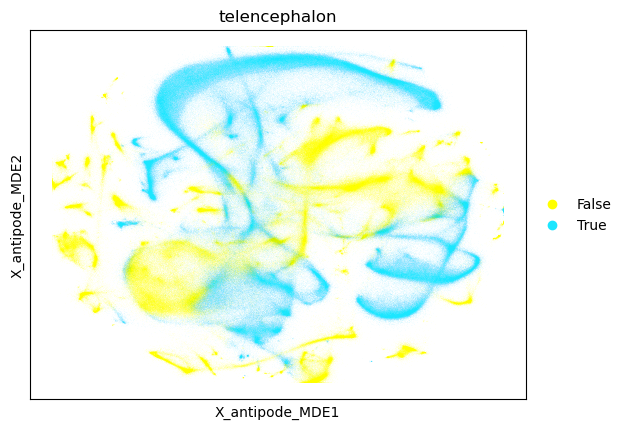

In [29]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['telencephalon'],
    palette=sc.pl.palettes.godsnot_102,
)

In [30]:
in_obs=pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/HvQvM/annotations/GSE169122_obs.csv.gz',index_col=0)

In [31]:
inds=adata.obs.index.str.replace(r'-\d+$', '', regex=True).str.replace(r'-\d+$', '', regex=True)
get_inds=inds[inds.isin(in_obs.index)]
adata.obs.loc[adata.obs.index[inds.isin(in_obs.index)],'initial_class']=list(in_obs.loc[adata.obs.index[inds.isin(in_obs.index)].str.replace(r'-\d+$', '', regex=True).str.replace(r'-\d+$', '', regex=True),'class'])

In [32]:
adata.obs.groupby('level_2')['initial_class'].value_counts().unstack()

/scratch/fast/16874833/ipykernel_7510/662381061.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby('level_2')['initial_class'].value_counts().unstack()


initial_class,CGE_NR2F2/PROX1,G1-phase_SLC1A3/ATP1A1,G2-M_UBE2C/ASPM,LGE_FOXP1/ISL1,LGE_FOXP1/PENK,LGE_FOXP2/TSHZ1,LGE_MEIS2/PAX6,MGE_CRABP1/MAF,MGE_CRABP1/TAC3,MGE_LHX6/MAF,MGE_LHX6/NPY,RMTW_ZIC1/RELN,S-phase_MCM4/H43C,Transition,VMF_ZIC1/ZIC2,nan
level_2,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3569
1,18,0,0,0,83,0,58,0,0,984,0,0,1,502,4,4858
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,14313
4,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,21565
6,18,0,0,12,7,4,4,28,7,193,173,5,0,0,32,2330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,10244
296,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6339
297,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3875


In [33]:
counts=adata.obs.groupby('level_2')['initial_class'].value_counts().unstack().drop('nan',axis=1)
counts=((10+counts.T)/((10+counts).T.sum(0))).T
counts['nan']=0.3
adata.obs['ic_extended']=adata.obs['level_2'].replace(counts.idxmax(1).to_dict())

/scratch/fast/16874833/ipykernel_7510/1791168578.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts=adata.obs.groupby('level_2')['initial_class'].value_counts().unstack().drop('nan',axis=1)
/scratch/fast/16874833/ipykernel_7510/1791168578.py:4: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['ic_extended']=adata.obs['level_2'].replace(counts.idxmax(1).to_dict())


In [34]:
counts

initial_class,CGE_NR2F2/PROX1,G1-phase_SLC1A3/ATP1A1,G2-M_UBE2C/ASPM,LGE_FOXP1/ISL1,LGE_FOXP1/PENK,LGE_FOXP2/TSHZ1,LGE_MEIS2/PAX6,MGE_CRABP1/MAF,MGE_CRABP1/TAC3,MGE_LHX6/MAF,MGE_LHX6/NPY,RMTW_ZIC1/RELN,S-phase_MCM4/H43C,Transition,VMF_ZIC1/ZIC2,nan
level_2,,,,,,,,,,,,,,,,
0,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.3
1,0.015556,0.005556,0.005556,0.005556,0.051667,0.005556,0.037778,0.005556,0.005556,0.552222,0.005556,0.005556,0.006111,0.284444,0.007778,0.3
2,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.3
4,0.065789,0.065789,0.065789,0.065789,0.065789,0.072368,0.065789,0.065789,0.065789,0.072368,0.065789,0.065789,0.065789,0.065789,0.065789,0.3
6,0.044234,0.015798,0.015798,0.034755,0.026856,0.022117,0.022117,0.060032,0.026856,0.320695,0.289100,0.023697,0.015798,0.015798,0.066351,0.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,0.066225,0.066225,0.066225,0.072848,0.066225,0.066225,0.066225,0.066225,0.066225,0.066225,0.066225,0.066225,0.066225,0.066225,0.066225,0.3
296,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.3
297,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.066667,0.3


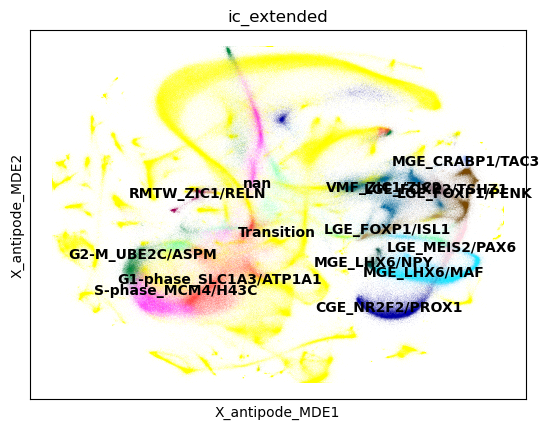

In [35]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['ic_extended'],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data'
)

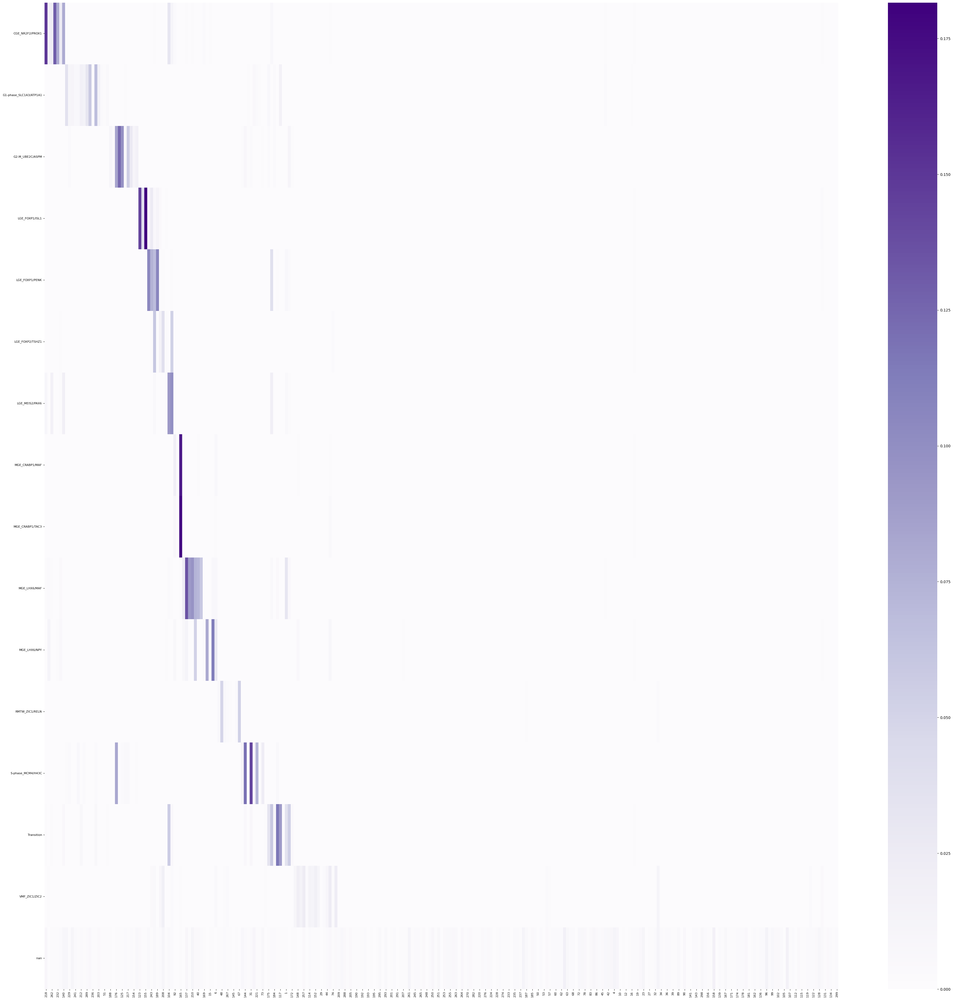

In [36]:
sc_analysis.create_heatmap(sc_analysis.get_cross_category_jaccard(adata.obs,'initial_class','level_2'),cmap='Purples')

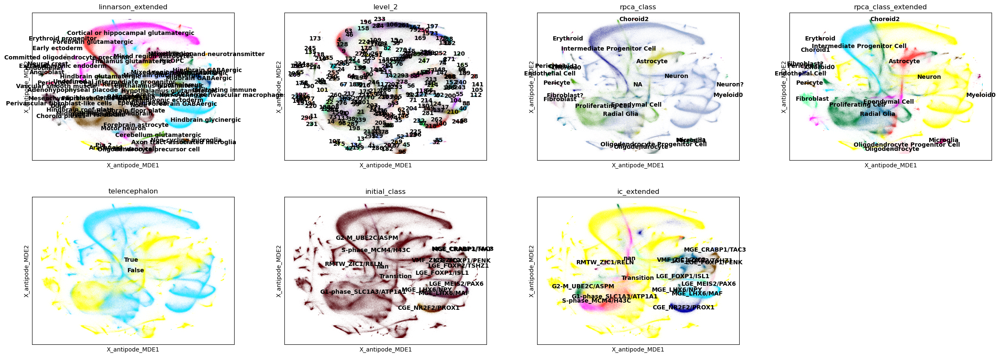

In [37]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["linnarson_extended",'level_2','rpca_class','rpca_class_extended','telencephalon','initial_class','ic_extended'],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data'
)

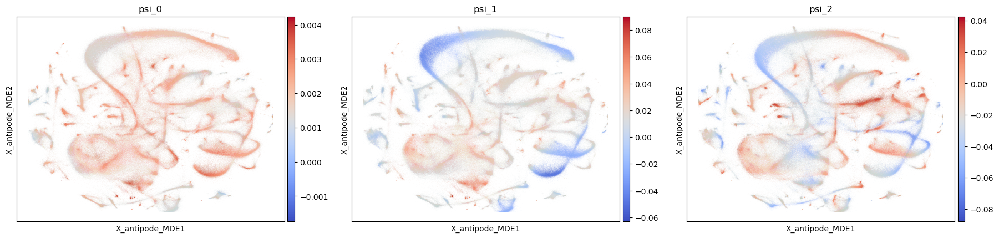

In [38]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=[x for x in adata.obs.columns if 'psi' in x],
    cmap='coolwarm',
    legend_loc='on data'
)

In [39]:
# Apply the function across the DataFrame rows
top_3_columns_per_row = adata.obs.groupby('level_2')['region'].value_counts().unstack().apply(antipode.post.get_n_largest(3), axis=1)
d=top_3_columns_per_row.to_dict()
d=dict(zip(d.keys(),[",".join(x) for x in d.values()]))

/scratch/fast/16874833/ipykernel_7510/2270799843.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  top_3_columns_per_row = adata.obs.groupby('level_2')['region'].value_counts().unstack().apply(antipode.post.get_n_largest(3), axis=1)


In [40]:
cdf=pd.read_csv('/home/matthew.schmitz/dev_level2_cluster_specific_markers.csv',index_col=0)
markers=cdf.apply(antipode.post.get_n_largest(3), axis=0)
markers_col=markers.apply(lambda x: ','.join(x.astype(str)), axis=0)
markers_col[cdf.max(0)<0.1]=''

In [41]:
gdf=pd.read_csv('/home/matthew.schmitz/dev_level2_cluster_general_markers.csv',index_col=0)
gen_markers=gdf.apply(antipode.post.get_n_largest(3), axis=0)
gen_markers_col=gen_markers.apply(lambda x: ','.join(x.astype(str)), axis=0)

In [42]:
rdf=pd.read_csv('/home/matthew.schmitz/dev_level2_real_specific_markers.csv',index_col=0)
rgen_markers=rdf.apply(antipode.post.get_n_largest(3), axis=0)
rgen_markers_col=rgen_markers.apply(lambda x: ','.join(x.astype(str)), axis=0)
rgen_markers_col[rdf.max(0)<0.1]=''

<Axes: ylabel='Count'>

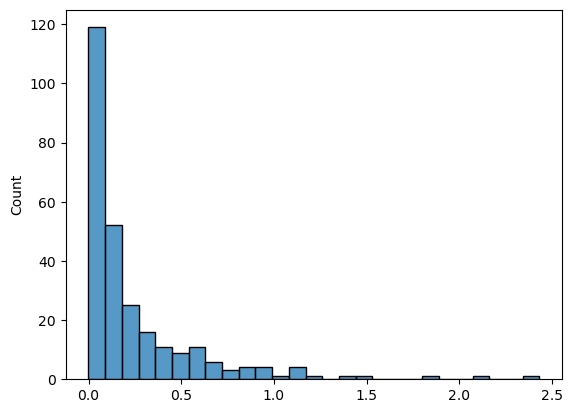

In [43]:
seaborn.histplot(cdf.max(0))

In [44]:
gdf['2'].sort_values()

TAC1      -0.554180
CARTPT    -0.542375
NTS       -0.517639
EOMES     -0.475041
RSPO3     -0.458953
             ...   
PAX2       0.318983
POLQ       0.323588
E2F8       0.342164
NEUROD2    0.361506
NKX6-2     0.440919
Name: 2, Length: 16738, dtype: float64

In [45]:
phase_table=adata.obs.groupby('level_2')['phase'].value_counts(normalize=True).unstack()

/scratch/fast/16874833/ipykernel_7510/3609101383.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  phase_table=adata.obs.groupby('level_2')['phase'].value_counts(normalize=True).unstack()


In [46]:
level_1=adata.obs.groupby('level_2')['level_1'].value_counts(normalize=True).unstack().idxmax(1)

/scratch/fast/16874833/ipykernel_7510/2229644354.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  level_1=adata.obs.groupby('level_2')['level_1'].value_counts(normalize=True).unstack().idxmax(1)


In [47]:
obs=adata.obs.loc[:,['level_2','ic_extended','rpca_class_extended','linnarson_extended']]
obs=obs.loc[~obs['level_2'].duplicated(),:]
obs['regions']=obs['level_2'].replace(d)
obs.index=list(obs['level_2'])
obs['level_1']=level_1
obs['markers']=markers_col
obs['gen_markers']=gen_markers_col
obs['real_markers']=rgen_markers_col
obs['phase']=phase_table.idxmax(1)
obs.to_csv('/home/matthew.schmitz/try_rectify_labels.csv')

/scratch/fast/16874833/ipykernel_7510/246844530.py:3: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  obs['regions']=obs['level_2'].replace(d)


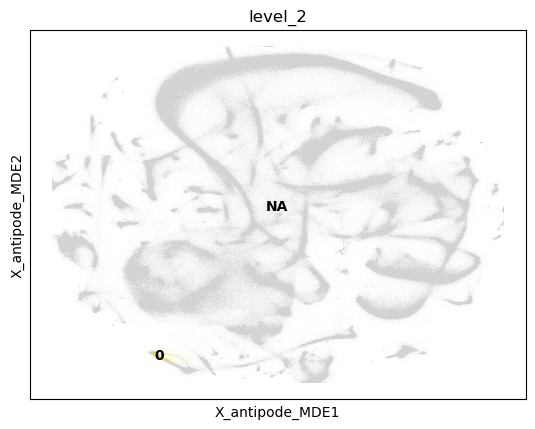

In [48]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['level_2'],groups=['0'],
    legend_loc='on data'
)

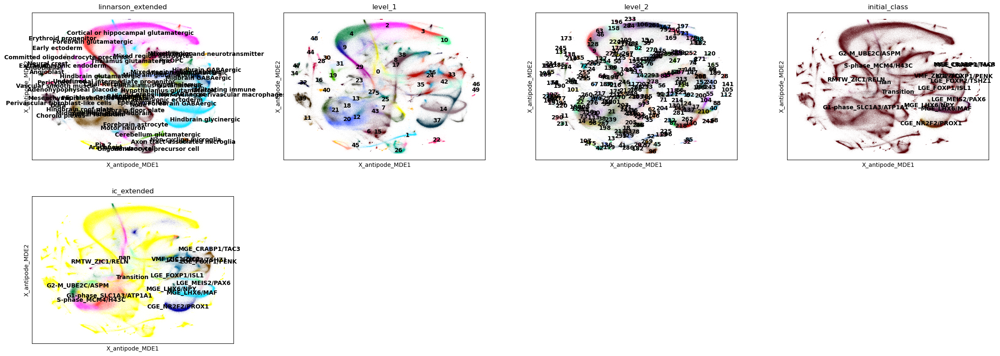

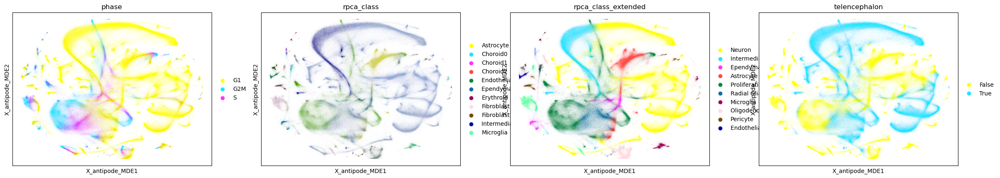

In [49]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["linnarson_extended",'level_1','level_2','initial_class','ic_extended'],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data'
)


sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['phase','rpca_class','rpca_class_extended','telencephalon'],
    palette=sc.pl.palettes.godsnot_102,
)

# Failure of MapMyCells

In [50]:
abc_subclass_means=pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/mouse_wb/AIT21.all.freeze.230815_subclassmeans.csv',index_col=0)

In [51]:
import json

# Path to your JSON file
file_path = '/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/HvQvM/HvQvMall_cere_clean_nodoublets_ABC_MAPPING/hann_results.json'

# Open the file and load its content
with open(file_path, 'r') as file:
    data = json.load(file)

rows = []
for item in data['results']:
    row = {
        'cell_id': item['cell_id'],
        'class_label': item['class_label']['assignment'],
        'supertype_label': item['supertype_label']['assignment'],
        'subclass_label': item['subclass_label']['assignment'],
        'class_label2': item['class_label']['runner_up_assignment'],
        'supertype_label2': item['supertype_label']['runner_up_assignment'],
        'subclass_label2': item['subclass_label']['runner_up_assignment']
    }
    rows.append(row)

# Create a DataFrame
df = pd.DataFrame(rows)
df['cell_id']=df['cell_id'].str.replace('-[0-9]+$','',regex=True).str.replace('-[0-9]+$','',regex=True)
df.index=list(df['cell_id'])
df=df.loc[df['cell_id'].isin(adata.obs.index),:]
df=df.loc[~df.index.duplicated(),:]
adata.obs.loc[:,["class_label", "supertype_label", "subclass_label"]]=df.loc[:,["class_label", "supertype_label", "subclass_label"]]


In [52]:
import json

# Path to your JSON file
file_path = '/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/HvQvM/HvQvMall_cere_clean_nodoublets_juvenile_MAPPING/hann_results.json'
#file_path = '/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/HvQvM/HvQvMall_cere_clean_nodoublets_juvenile-TFonly_MAPPING//hann_results.json'

# Open the file and load its content
with open(file_path, 'r') as file:
    data = json.load(file)

rows = []
for item in data['results']:
    row = {
        'cell_id': item['cell_id'],
        'class_label': item['class_label']['assignment'],
        'supertype_label': item['supertype_label']['assignment'],
        'subclass_label': item['subclass_label']['assignment']
    }
    rows.append(row)

# Create a DataFrame
df = pd.DataFrame(rows)
df['cell_id']=df['cell_id'].str.replace('-[0-9]+$','',regex=True).str.replace('-[0-9]+$','',regex=True)
df.index=list(df['cell_id'])
df=df.loc[df['cell_id'].isin(adata.obs.index),:]
df=df.loc[~df.index.duplicated(),:]
df.columns=['juvenile_'+x for x in df.columns]
adata.obs.loc[df.index,["juvenile_class_label", "juvenile_supertype_label", "juvenile_subclass_label"]]=df.loc[:,["juvenile_class_label", "juvenile_supertype_label", "juvenile_subclass_label"]]

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


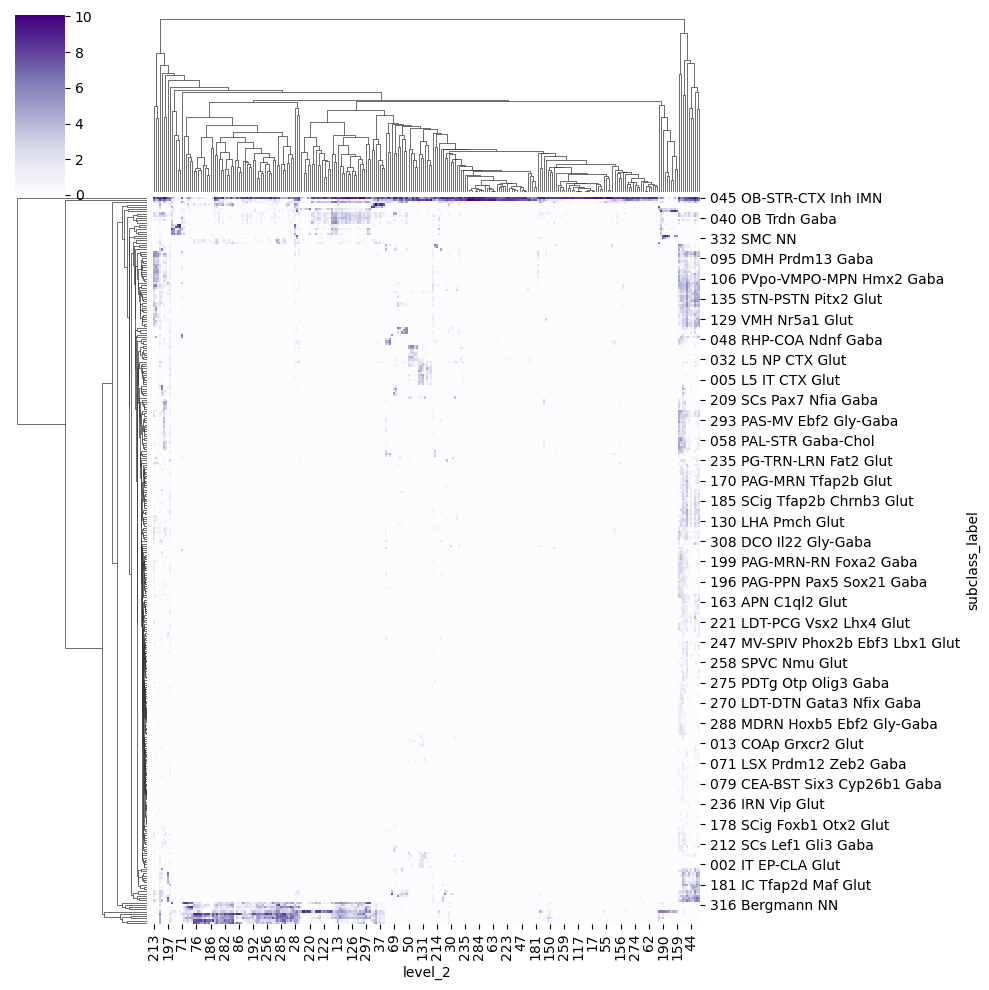

In [53]:
seaborn.clustermap(np.log(adata.obs.groupby('subclass_label')['level_2'].value_counts().unstack()+1),cmap='Purples')

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


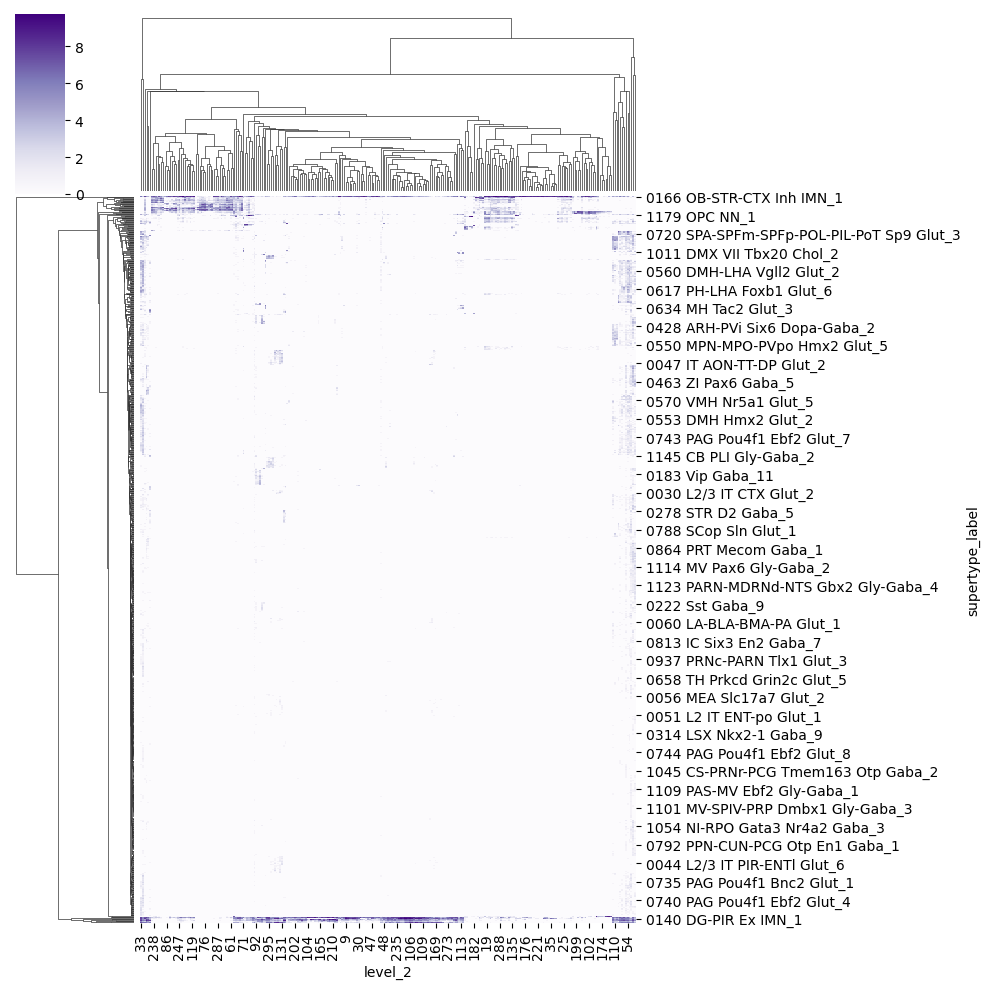

In [54]:
seaborn.clustermap(np.log(adata.obs.groupby('supertype_label')['level_2'].value_counts().unstack()+1),cmap='Purples')

/scratch/fast/16874833/ipykernel_7510/1542553147.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  seaborn.clustermap(np.log(adata.obs.groupby('general_region')['subclass_label'].value_counts().unstack()+1))


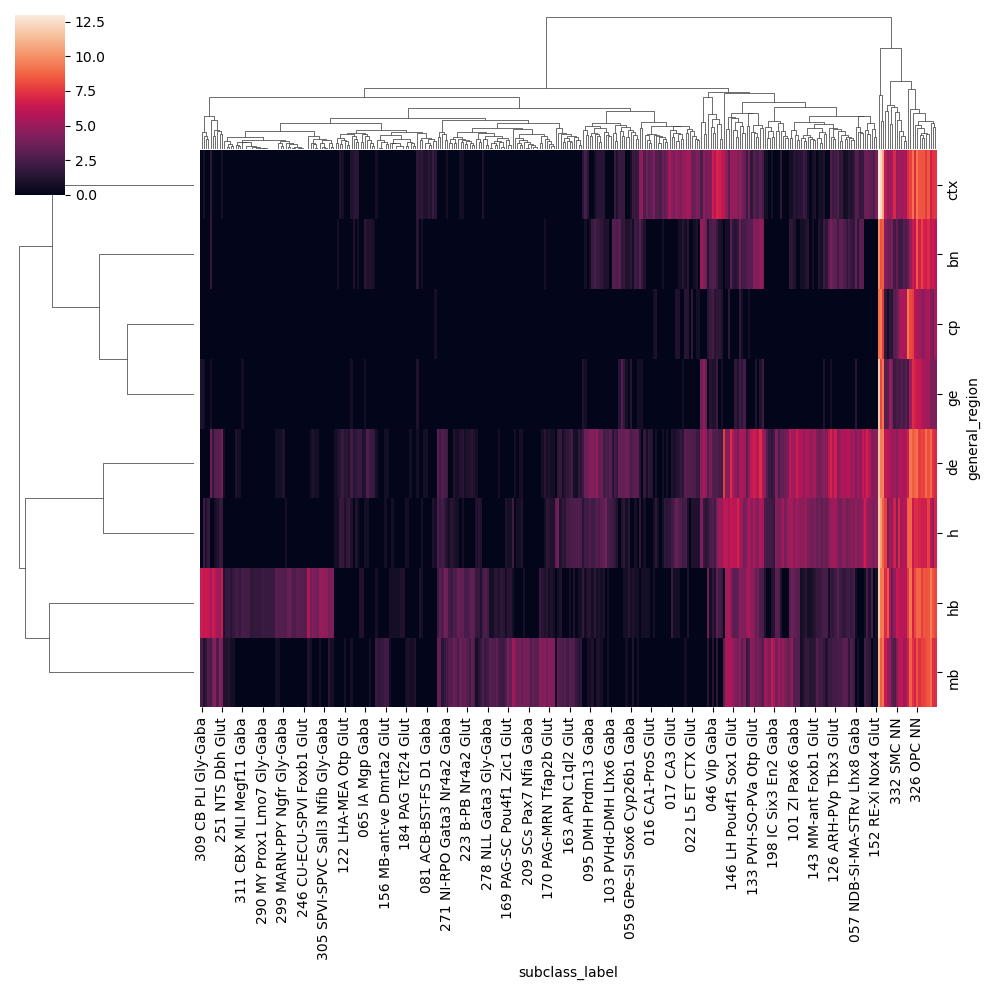

In [55]:
seaborn.clustermap(np.log(adata.obs.groupby('general_region')['subclass_label'].value_counts().unstack()+1))

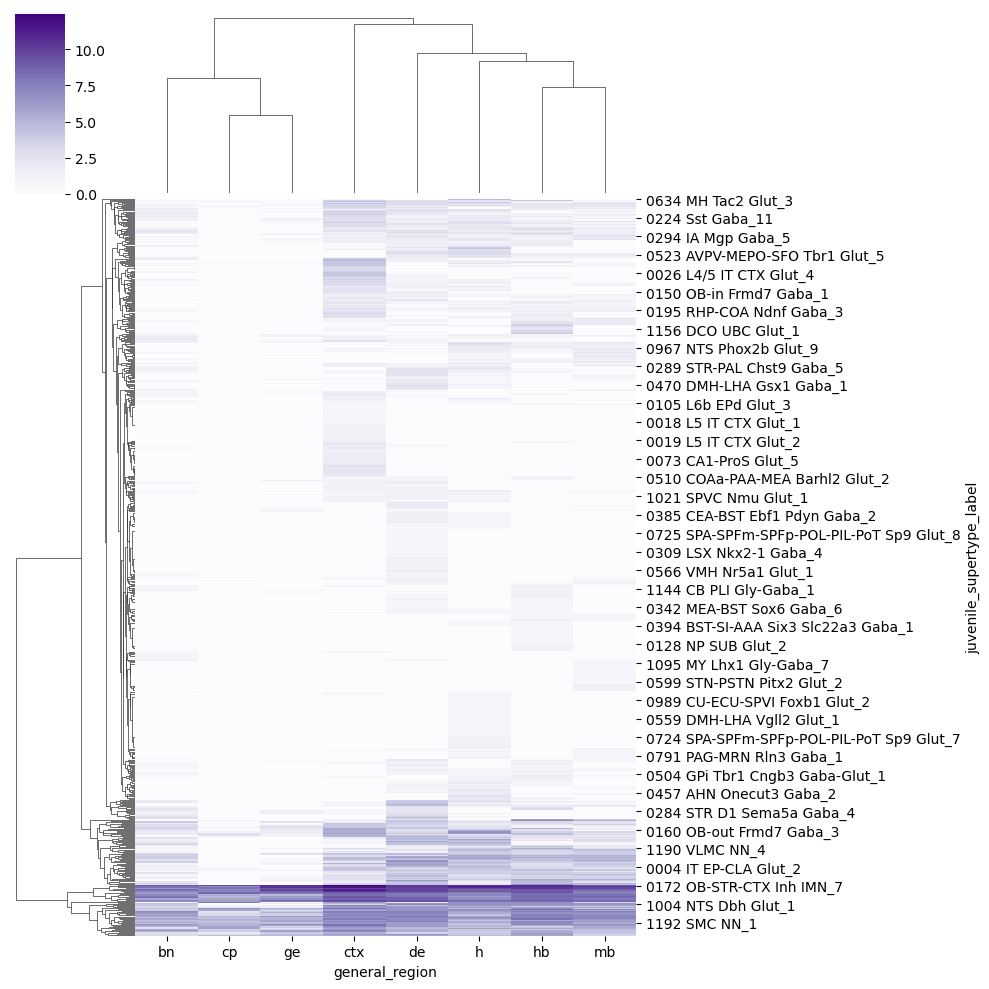

In [56]:
seaborn.clustermap(np.log(adata.obs.groupby('juvenile_supertype_label')['general_region'].value_counts().unstack()+1),cmap='Purples')

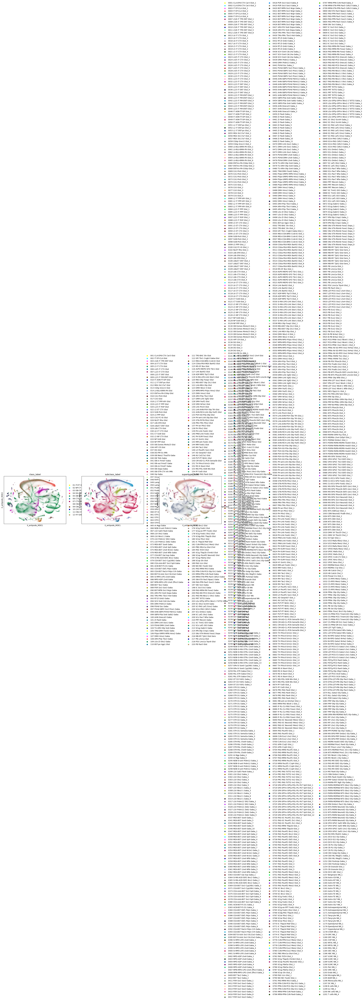

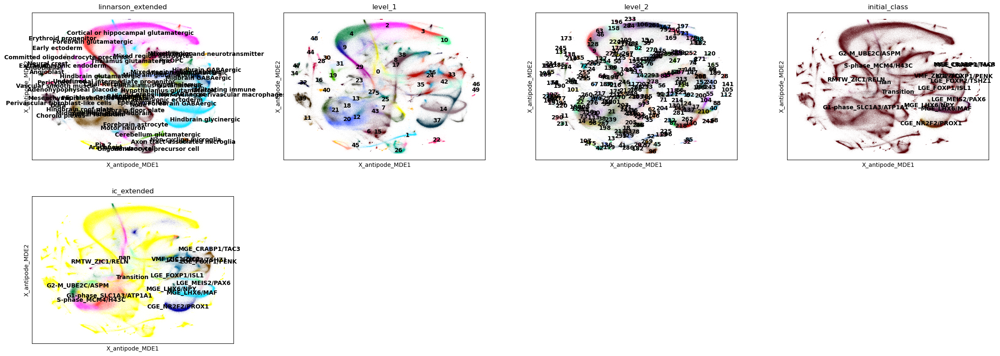

In [57]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["class_label","subclass_label",'supertype_label'],
    palette=sc.pl.palettes.godsnot_102,
)



sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["linnarson_extended",'level_1','level_2','initial_class','ic_extended'],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data'
)


# Success of TF correlation in juvenile

Used ABC (Yao 2023) subclasses in the dataset or with ABC mapped onto mouse juvenile (Linnarson)

In [58]:
abc_subclass_means=pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/mouse_wb/AIT21.all.freeze.230815_subclassmeans.csv',index_col=0)

In [59]:
# adata=adata.to_memory()
# adata.layers['norm_spliced']=adata.layers['spliced'].copy()
# tpm=1e6*(adata.layers['norm_spliced']/adata.layers['norm_spliced'].sum(1))
# tpm.data=np.log(tpm.data+1.)
# adata.layers['norm_spliced']=scipy.sparse.csr_matrix(tpm)

#adata.layers['norm_spliced']=adata.X.copy()#adata.layers['spliced'].copy()
#adata.layers['norm_spliced']=scipy.sparse.csr_matrix(1e4*(adata.layers['norm_spliced']/adata.layers['norm_spliced'].sum(1)))

In [60]:
aggr_means=antipode.model_functions.group_aggr_anndata(adata,['species','level_2'])
log_real_means=aggr_means[0] # #species,#cluster,#genes array

100%|██████████| 813/813 [14:05<00:00,  1.04s/it]  


In [61]:
dev_mouse_means=pd.DataFrame(log_real_means[2],columns=adata.var.index,index=aggr_means[1]['level_2'])

In [62]:
dev_mouse_means=dev_mouse_means.loc[:,dev_mouse_means.columns.isin(abc_subclass_means.columns)]

In [63]:
abc_subclass_means=abc_subclass_means.loc[:,abc_subclass_means.columns.isin(dev_mouse_means.columns)]
abc_subclass_means=abc_subclass_means.loc[:,sorted(abc_subclass_means.columns)]

In [64]:
#Remove the OB granule cells because their immaturity is a magnet for all dev cells
abc_subclass_means=abc_subclass_means.loc[~abc_subclass_means.index.str.contains('OB-STR'),:]

In [65]:
# gl_path='/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/gene_lists/'
# tf_genes=pd.read_csv(os.path.join(gl_path,'TFs_lambert_pmid29425488_1.01.txt'),sep='\t')
# include_genes=tf_genes['hgnc_symbol']

In [66]:
tf_genes=pd.read_csv('/home/matthew.schmitz/Matthew/utils/zizhens_tf_code.txt',sep='\t')
include_genes=tf_genes['gene'].str.upper()

In [67]:
#include_genes=dev_mouse_means.loc[:,dev_mouse_means.columns.isin(include_genes)].std(0).sort_values()[-100:].index
#include_genes=abc_subclass_means.loc[:,abc_subclass_means.columns.isin(include_genes)].std(0).sort_values()[-100:].index

In [68]:
corrs=sc_analysis.corr2_coeff(dev_mouse_means.loc[:,dev_mouse_means.columns.isin(include_genes)],abc_subclass_means.loc[:,abc_subclass_means.columns.isin(include_genes)])
#thresh=2.
#corrs=sc_analysis.corr2_coeff((dev_mouse_means.loc[:,dev_mouse_means.columns.isin(include_genes)]>thresh).astype(float),(abc_subclass_means.loc[:,abc_subclass_means.columns.isin(include_genes)]>thresh*2).astype(float))

corrs=np.nan_to_num(corrs,0.)
corrs=pd.DataFrame(corrs,index=dev_mouse_means.index,columns=abc_subclass_means.index)

/home/matthew.schmitz/utils/mts-utils/genomics/sc_analysis.py:297: RuntimeWarning: invalid value encountered in divide
  return np.dot(A_mA, B_mB.T) / np.sqrt(np.dot(np.array(ssA)[:, None],np.array(ssB)[None]))


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


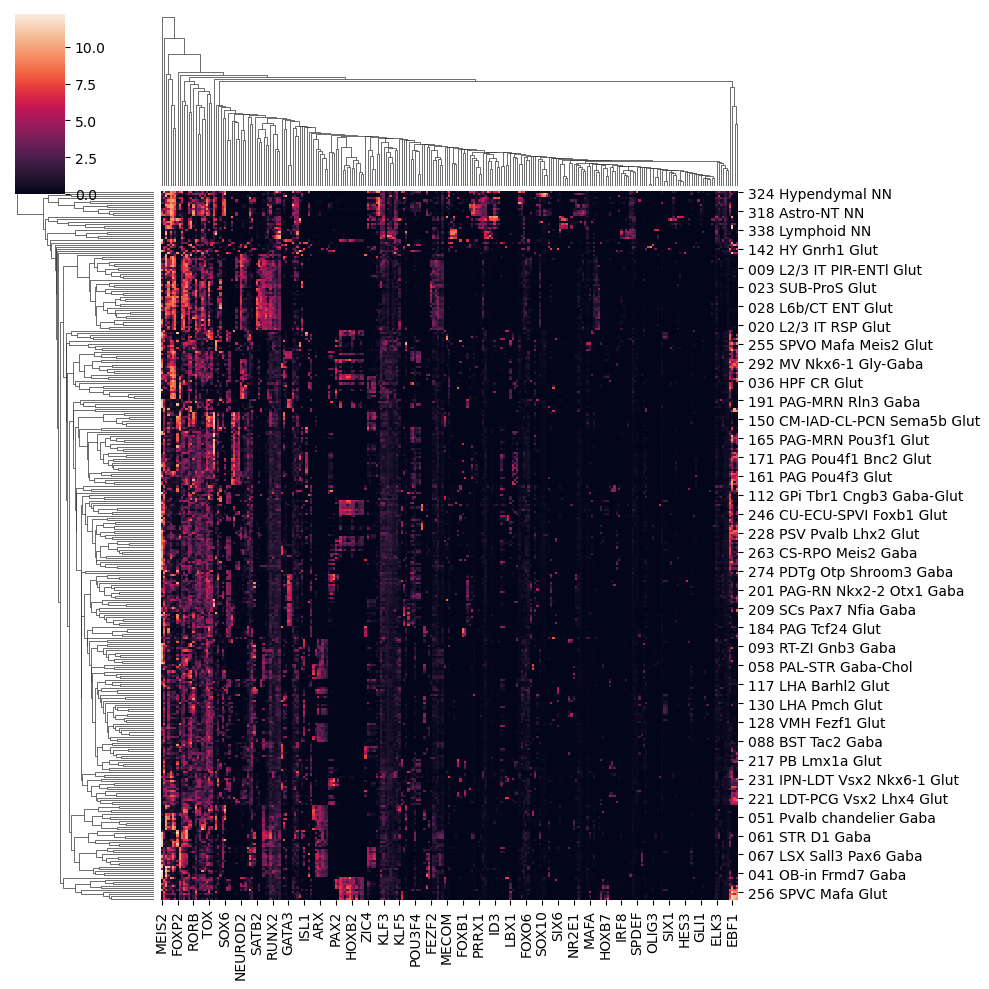

In [69]:
seaborn.clustermap(abc_subclass_means.loc[:,abc_subclass_means.columns.isin(include_genes)],col_cluster=True)

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


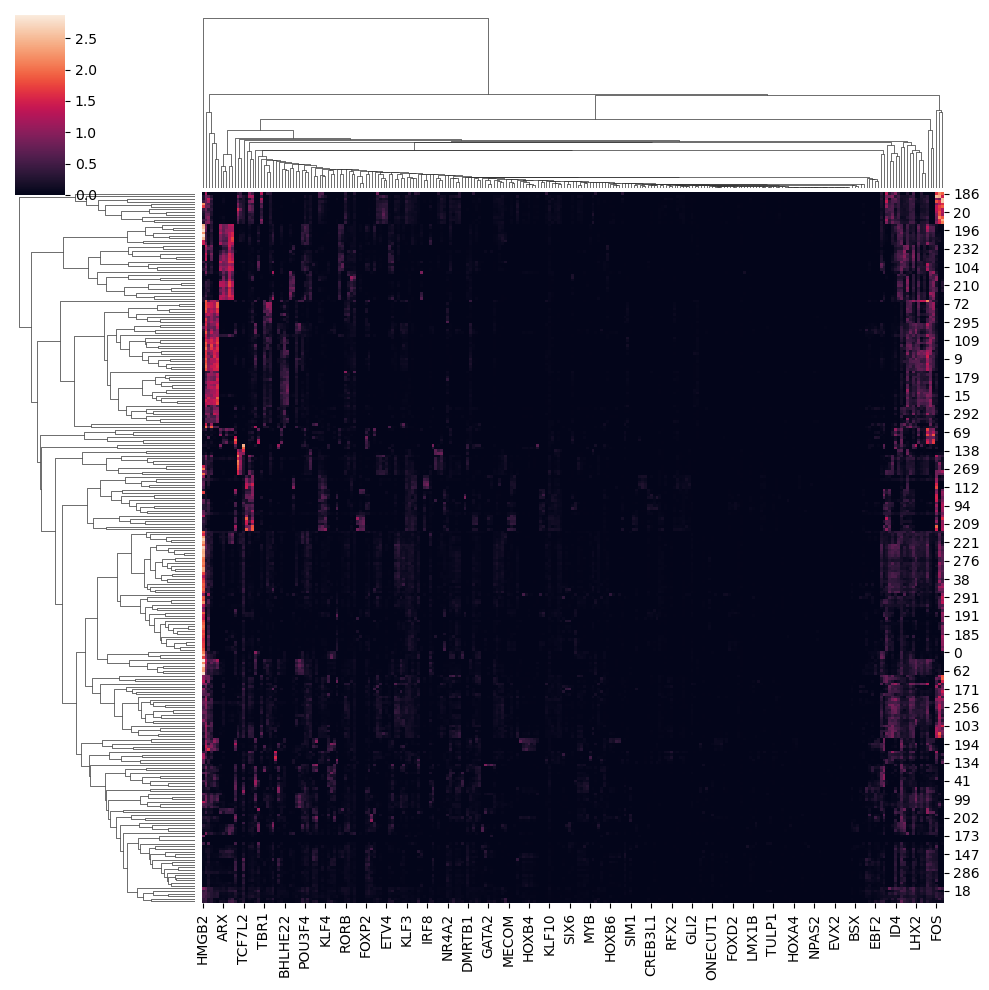

In [70]:
seaborn.clustermap(dev_mouse_means.loc[:,dev_mouse_means.columns.isin(include_genes)],col_cluster=True)

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


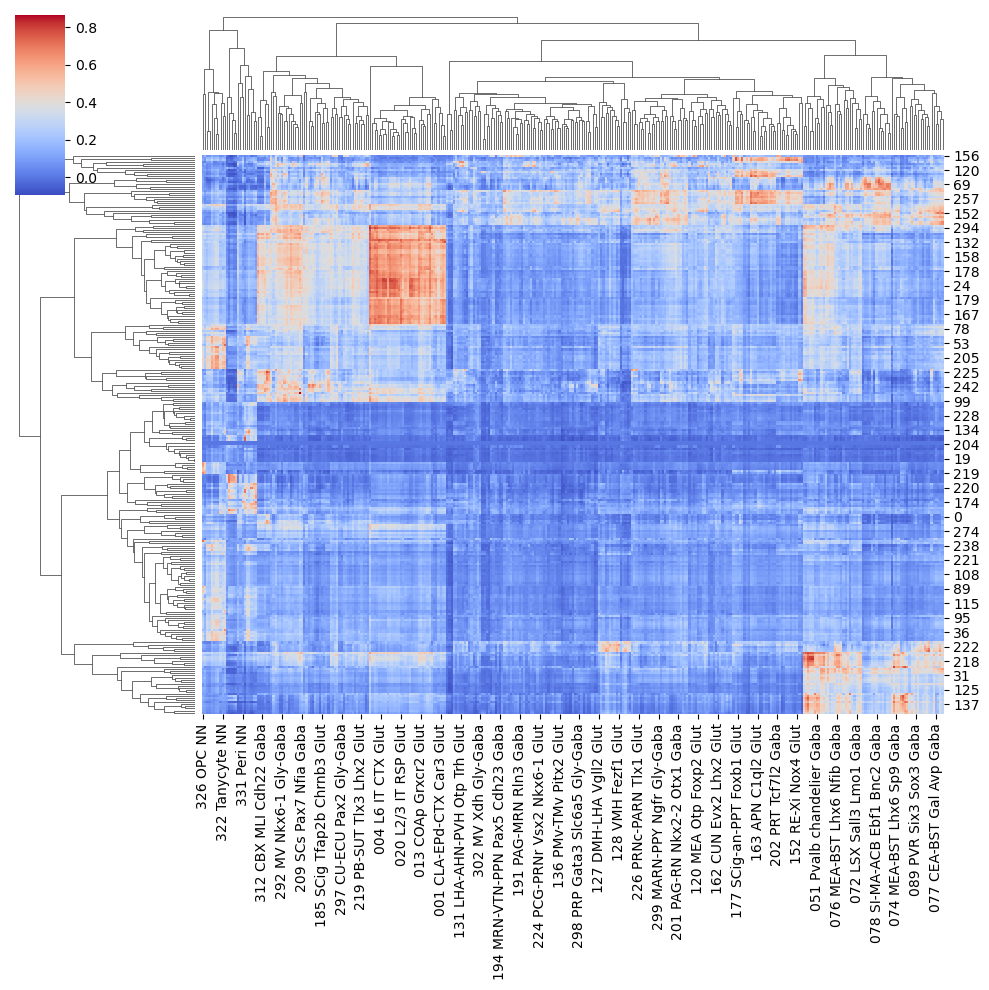

In [71]:
seaborn.clustermap(corrs,cmap='coolwarm')

In [72]:
marker_corr_dict=corrs.idxmax(1).to_dict()

In [73]:
adata.obs['abc_subclass_markercor']=adata.obs['level_2'].replace(marker_corr_dict)

/scratch/fast/16874833/ipykernel_7510/2388615560.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['abc_subclass_markercor']=adata.obs['level_2'].replace(marker_corr_dict)


/scratch/fast/16874833/ipykernel_7510/3493286869.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  seaborn.clustermap(np.log(adata.obs.groupby('level_2')['abc_subclass_markercor'].value_counts().unstack()+1),cmap='Purples')
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


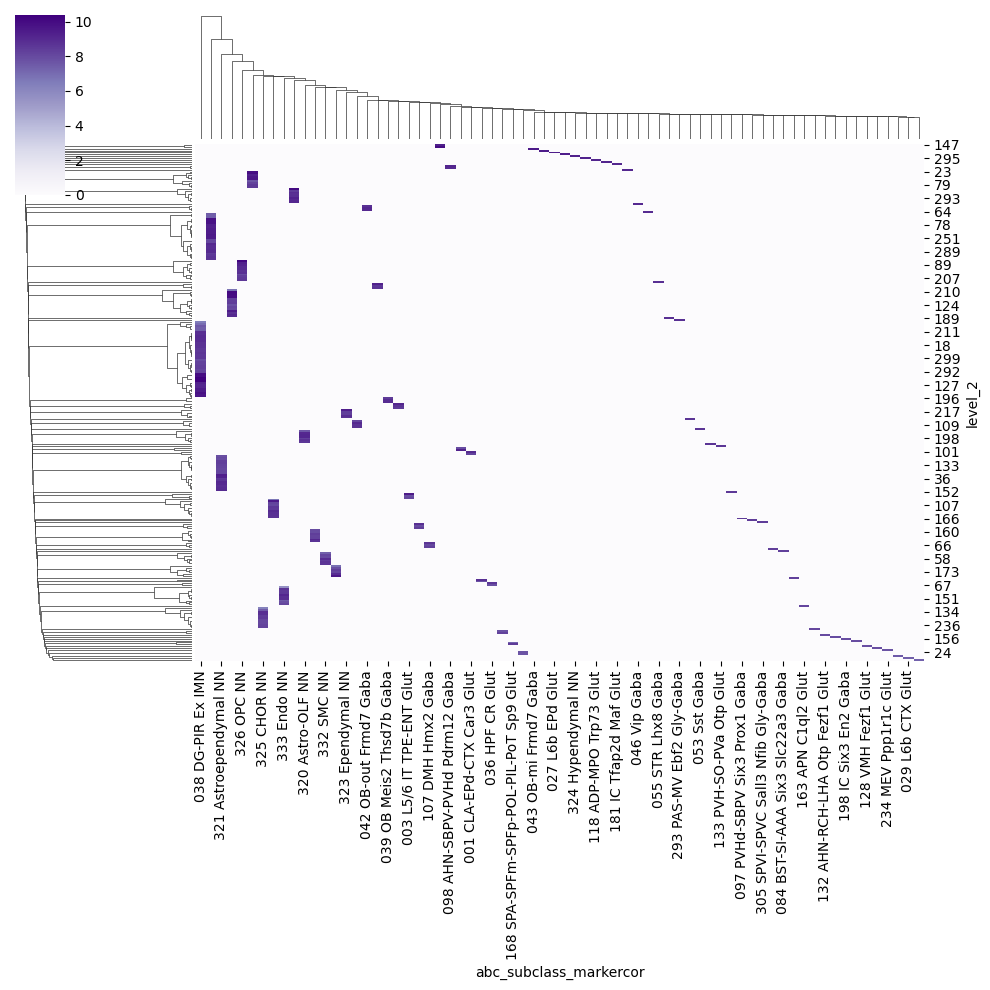

In [74]:
seaborn.clustermap(np.log(adata.obs.groupby('level_2')['abc_subclass_markercor'].value_counts().unstack()+1),cmap='Purples')

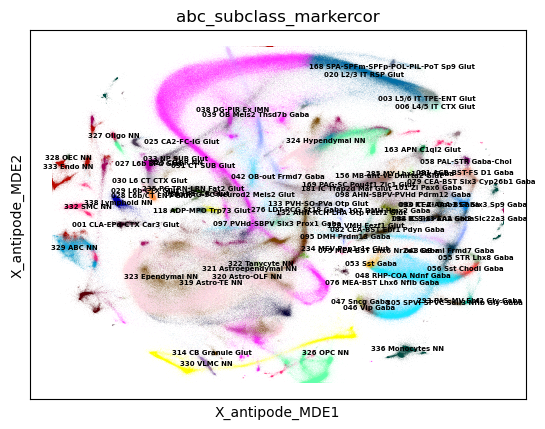

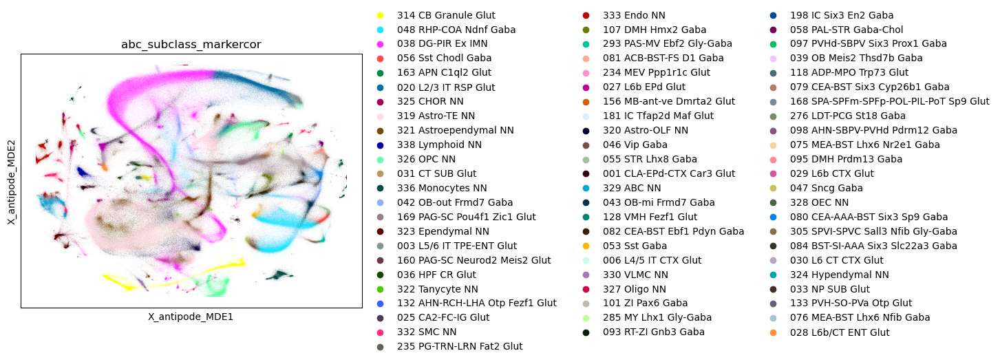

In [75]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["abc_subclass_markercor"],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data',legend_fontsize=5
    
)
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["abc_subclass_markercor"],
    palette=sc.pl.palettes.godsnot_102
)

In [76]:
# Apply the function across the DataFrame rows
top_5_maps = corrs.apply(antipode.post.get_n_largest(5), axis=1)
d=top_5_maps.to_dict()
top_5_maps=dict(zip(d.keys(),[",".join(x) for x in d.values()]))

In [77]:
top_5_maps

{'0': '314 CB Granule Glut,315 DCO UBC Glut,262 Pineal Crx Glut,250 CBN Neurod2 Pvalb Glut,310 CBX Golgi Gly-Gaba',
 '1': '048 RHP-COA Ndnf Gaba,097 PVHd-SBPV Six3 Prox1 Gaba,043 OB-mi Frmd7 Gaba,075 MEA-BST Lhx6 Nr2e1 Gaba,098 AHN-SBPV-PVHd Pdrm12 Gaba',
 '2': '038 DG-PIR Ex IMN,007 L2/3 IT CTX Glut,020 L2/3 IT RSP Glut,016 CA1-ProS Glut,025 CA2-FC-IG Glut',
 '4': '038 DG-PIR Ex IMN,025 CA2-FC-IG Glut,016 CA1-ProS Glut,027 L6b EPd Glut,010 IT AON-TT-DP Glut',
 '6': '056 Sst Chodl Gaba,075 MEA-BST Lhx6 Nr2e1 Gaba,057 NDB-SI-MA-STRv Lhx8 Gaba,053 Sst Gaba,048 RHP-COA Ndnf Gaba',
 '8': '163 APN C1ql2 Glut,169 PAG-SC Pou4f1 Zic1 Glut,167 PRC-PAG Tcf7l2 Irx2 Glut,181 IC Tfap2d Maf Glut,174 PAG Pou4f2 Mesi2 Glut',
 '9': '038 DG-PIR Ex IMN,025 CA2-FC-IG Glut,027 L6b EPd Glut,017 CA3 Glut,016 CA1-ProS Glut',
 '10': '020 L2/3 IT RSP Glut,016 CA1-ProS Glut,038 DG-PIR Ex IMN,007 L2/3 IT CTX Glut,003 L5/6 IT TPE-ENT Glut',
 '11': '325 CHOR NN,324 Hypendymal NN,323 Ependymal NN,321 Astroependymal 

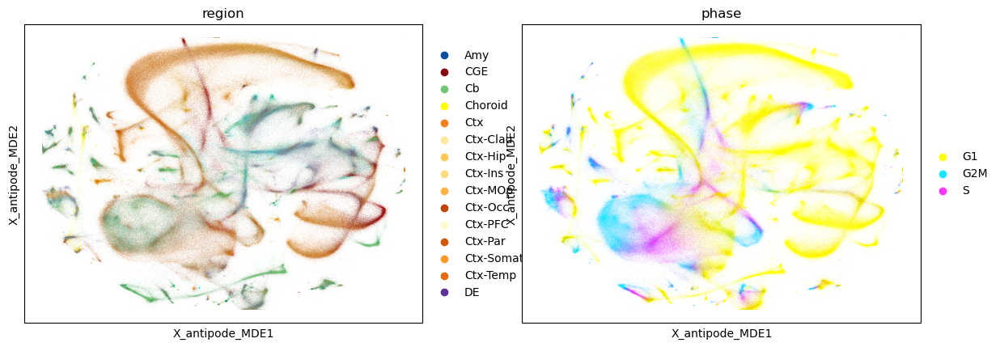

In [78]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["region",'phase'],
)

In [79]:
juvdata=sc.read_h5ad(os.path.expanduser('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/extra/KDCbVelocityMouseWbAdultPresupervisionHumanOrthos.h5ad'),backed='r')

In [80]:
# juvdata=juvdata.to_memory()
# adata.layers['norm_spliced']=adata.layers['spliced'].copy()
# adata.layers['norm_spliced']=scipy.sparse.csr_matrix(np.log(1e6*(adata.layers['norm_spliced']/adata.layers['norm_spliced'].sum(1))+1))

# juvdata=juvdata.to_memory()
# juvdata.layers['norm_spliced']=juvdata.layers['spliced'].copy()
# tpm=1e6*(juvdata.layers['norm_spliced']/juvdata.layers['norm_spliced'].sum(1))
# tpm.data=np.log(tpm.data+1.)
# juvdata.layers['norm_spliced']=scipy.sparse.csr_matrix(tpm)

In [81]:
juv_aggr_means=antipode.model_functions.group_aggr_anndata(juvdata,['subclass_label'])
juv_log_real_means=juv_aggr_means[0]

100%|██████████| 327/327 [03:09<00:00,  1.73it/s]


In [82]:
juv_mouse_means=pd.DataFrame(juv_log_real_means,columns=juvdata.var.index,index=juv_aggr_means[1]['subclass_label'])

In [83]:
juv_mouse_means=juv_mouse_means.loc[:,juv_mouse_means.columns.isin(dev_mouse_means.columns)]
dev_mouse_means=dev_mouse_means.loc[:,dev_mouse_means.columns.isin(juv_mouse_means.columns)]
juv_mouse_means=juv_mouse_means.loc[:,dev_mouse_means.columns]

In [84]:
tf_genes=pd.read_csv('/home/matthew.schmitz/Matthew/utils/zizhens_tf_code.txt',sep='\t')
include_genes=tf_genes['gene'].str.upper()

In [85]:
corrs=sc_analysis.corr2_coeff(dev_mouse_means.loc[:,dev_mouse_means.columns.isin(include_genes)],juv_mouse_means.loc[:,juv_mouse_means.columns.isin(include_genes)])
#thresh=2.
#corrs=sc_analysis.corr2_coeff((dev_mouse_means.loc[:,dev_mouse_means.columns.isin(include_genes)]>thresh).astype(float),(abc_subclass_means.loc[:,abc_subclass_means.columns.isin(include_genes)]>thresh*2).astype(float))

corrs=np.nan_to_num(corrs,0.)
corrs=pd.DataFrame(corrs,index=dev_mouse_means.index,columns=juv_mouse_means.index)

/home/matthew.schmitz/utils/mts-utils/genomics/sc_analysis.py:297: RuntimeWarning: invalid value encountered in divide
  return np.dot(A_mA, B_mB.T) / np.sqrt(np.dot(np.array(ssA)[:, None],np.array(ssB)[None]))


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


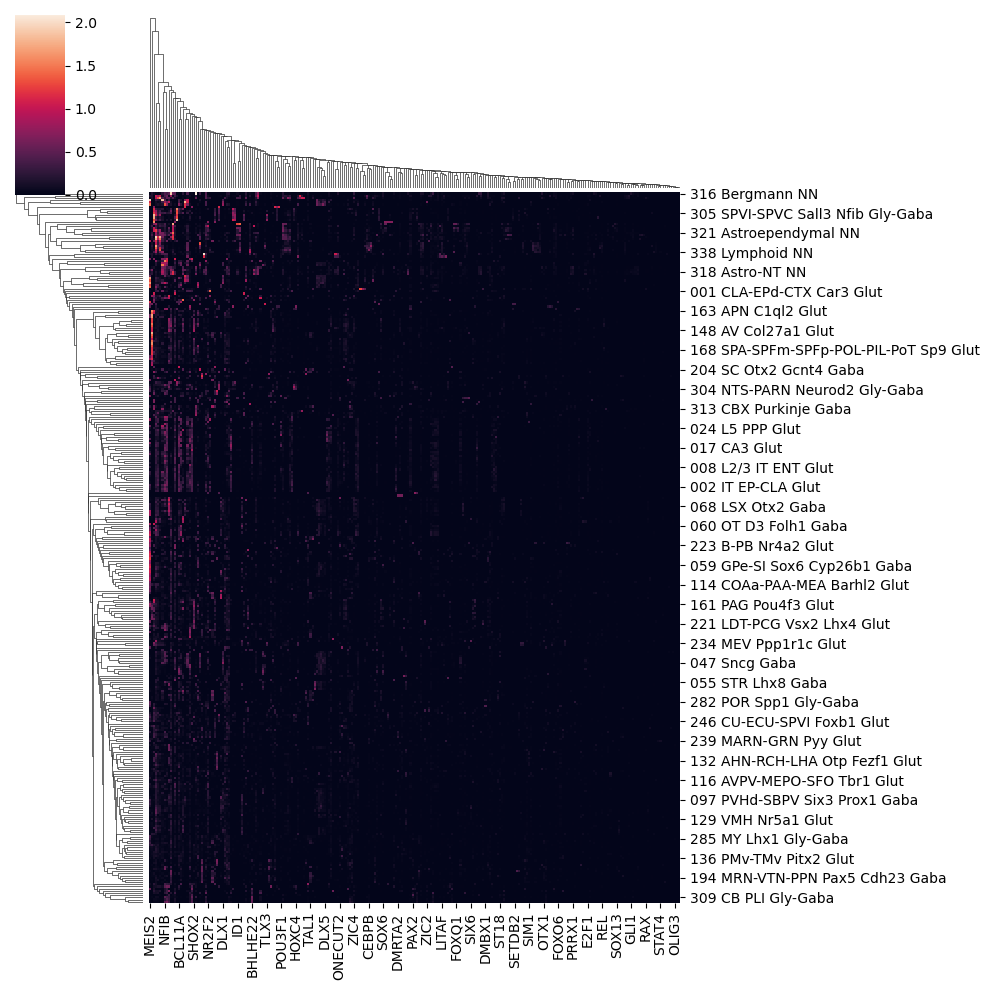

In [86]:
seaborn.clustermap(juv_mouse_means.loc[:,juv_mouse_means.columns.isin(include_genes)],col_cluster=True)

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


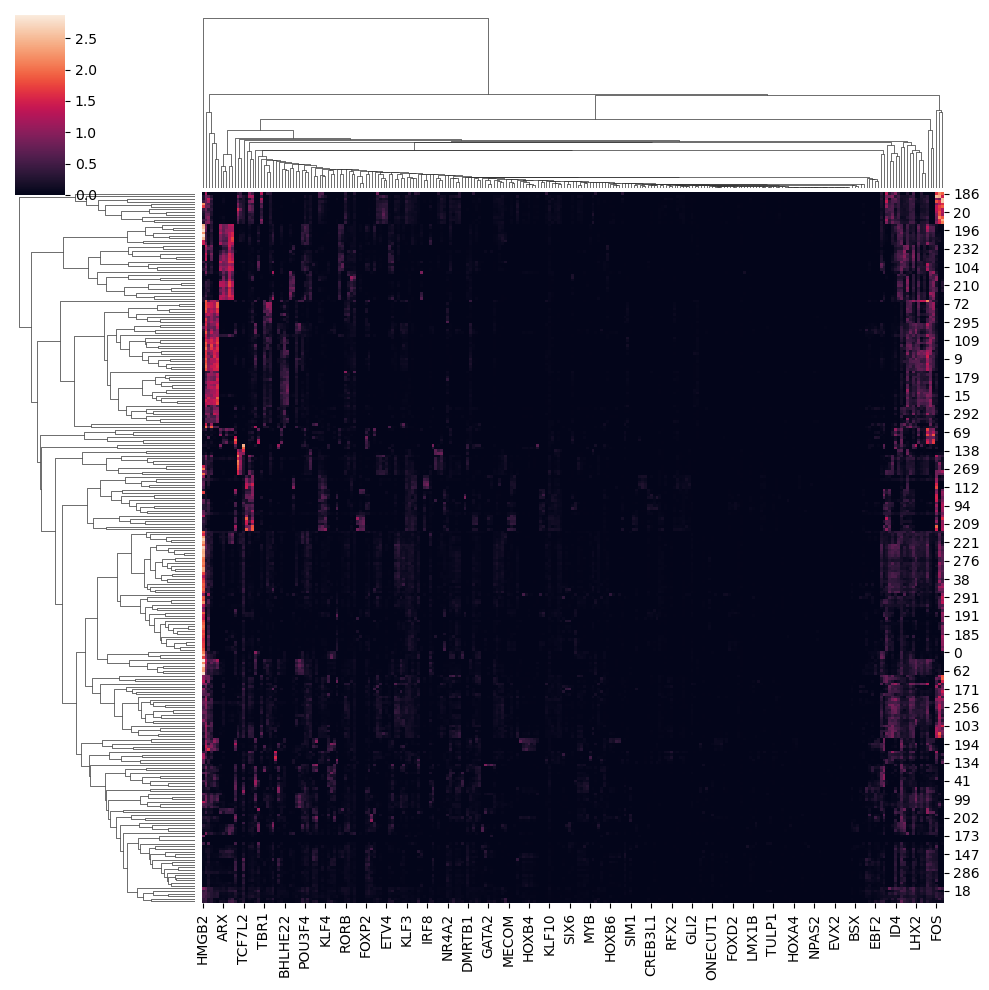

In [87]:
seaborn.clustermap(dev_mouse_means.loc[:,dev_mouse_means.columns.isin(include_genes)],col_cluster=True)

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


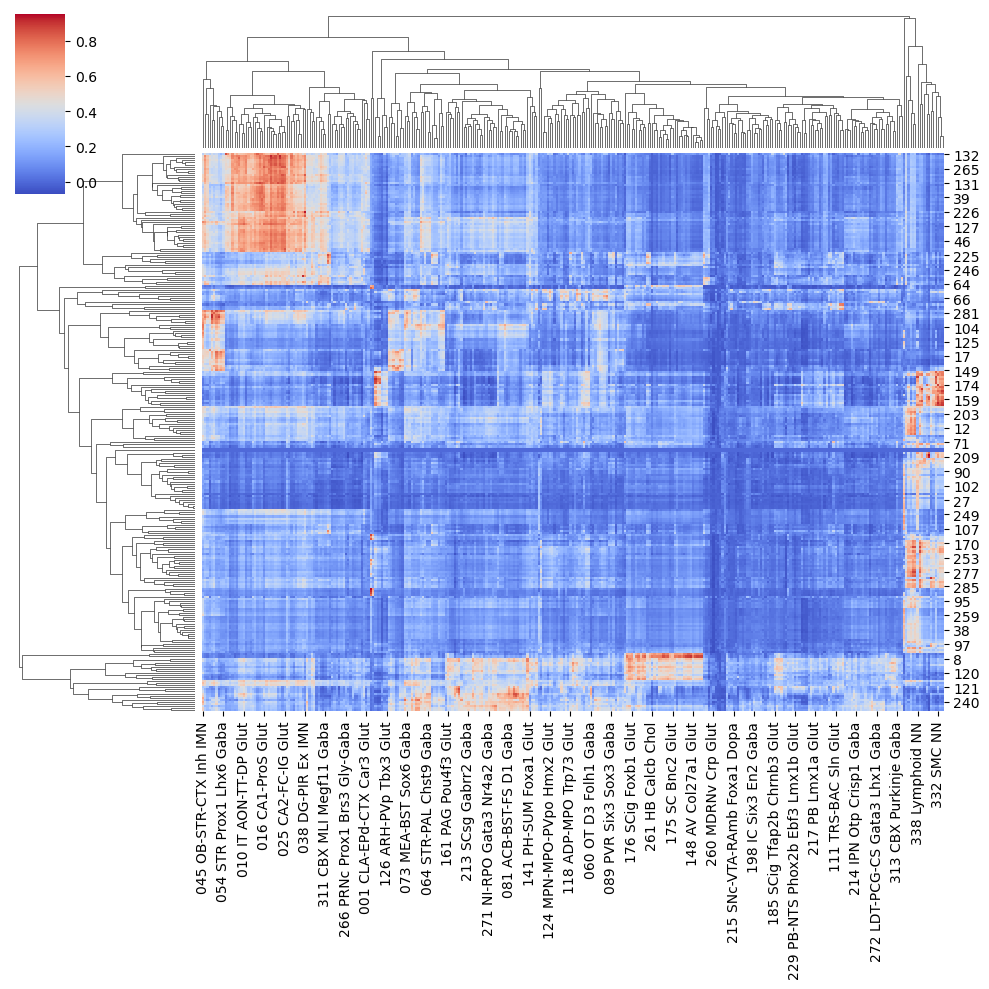

In [88]:
seaborn.clustermap(corrs,cmap='coolwarm')

In [89]:
marker_corr_dict=corrs.idxmax(1).to_dict()

In [90]:
adata.obs['juv_subclass_markercor']=adata.obs['level_2'].replace(marker_corr_dict)

/scratch/fast/16874833/ipykernel_7510/618301803.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['juv_subclass_markercor']=adata.obs['level_2'].replace(marker_corr_dict)


/scratch/fast/16874833/ipykernel_7510/4244405948.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  seaborn.clustermap(np.log(adata.obs.groupby('level_2')['juv_subclass_markercor'].value_counts().unstack()+1),cmap='Purples')
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


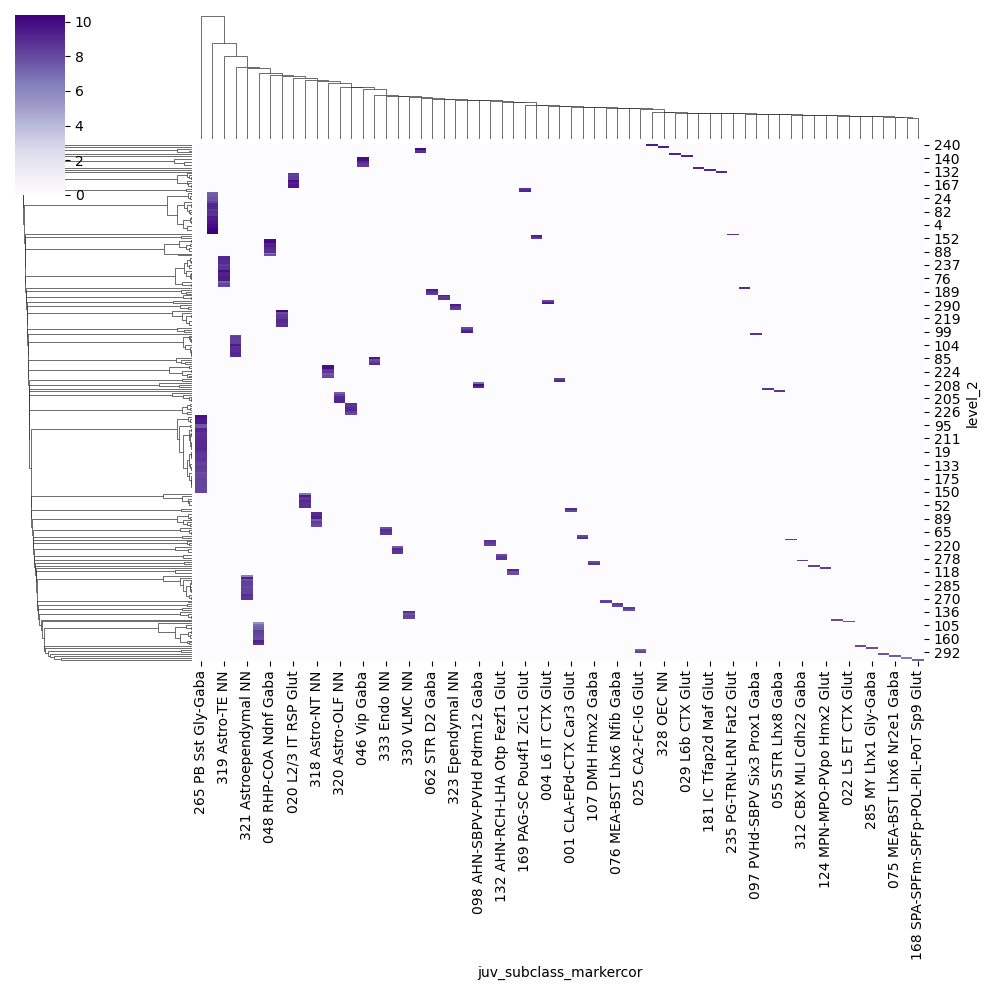

In [91]:
seaborn.clustermap(np.log(adata.obs.groupby('level_2')['juv_subclass_markercor'].value_counts().unstack()+1),cmap='Purples')

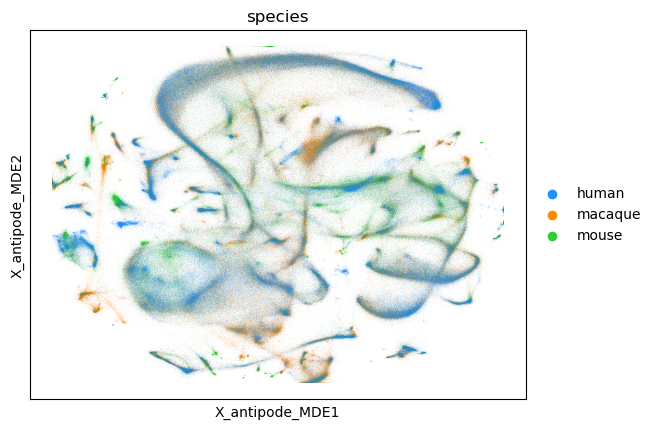

In [92]:
adata.uns['species_colors']=[adata.uns['species_color_dict'][x] for x in adata.obs['species'].cat.categories]
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["species"],
)

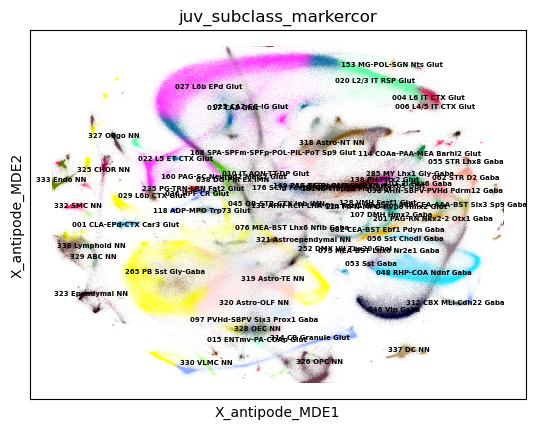

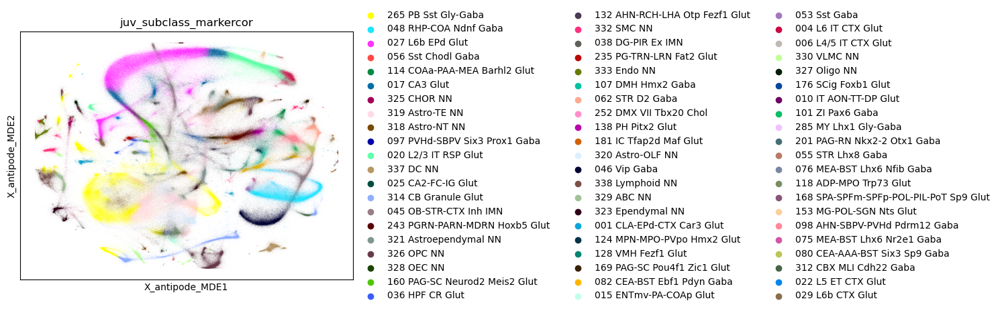

In [93]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["juv_subclass_markercor"],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data',legend_fontsize=5
    
)
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["juv_subclass_markercor"],
    palette=sc.pl.palettes.godsnot_102
)

In [94]:
#Get top 5 mappings for each level 2
top_5_maps = corrs.apply(antipode.post.get_n_largest(5), axis=1)
d=top_5_maps.to_dict()
top_5_maps_dict=dict(zip(d.keys(),[",".join(x) for x in d.values()]))

In [95]:
s2cdict=juvdata.obs.groupby('subclass_label')['class_label'].value_counts().unstack().idxmax(1).to_dict()

/scratch/fast/16874833/ipykernel_7510/1633166872.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  s2cdict=juvdata.obs.groupby('subclass_label')['class_label'].value_counts().unstack().idxmax(1).to_dict()


In [96]:
class_corrs=corrs.copy()
class_corrs.columns=class_corrs.columns.to_series().replace(s2cdict)

In [97]:
top_5_class_maps = class_corrs.apply(antipode.post.get_n_largest(5), axis=1)
d=top_5_class_maps.to_dict()
top_5_class_maps_dict=dict(zip(d.keys(),[",".join(x) for x in d.values()]))

In [98]:
top_5_class_maps_dict

{'0': '26 P GABA,29 CB Glut,34 Immune,29 CB Glut,16 HY MM Glut',
 '1': '06 CTX-CGE GABA,05 OB-IMN GABA,06 CTX-CGE GABA,06 CTX-CGE GABA,12 HY GABA',
 '2': '02 NP-CT-L6b Glut,01 IT-ET Glut,01 IT-ET Glut,01 IT-ET Glut,01 IT-ET Glut',
 '4': '02 NP-CT-L6b Glut,02 NP-CT-L6b Glut,01 IT-ET Glut,01 IT-ET Glut,01 IT-ET Glut',
 '6': '08 CNU-MGE GABA,11 CNU-HYa GABA,08 CNU-MGE GABA,06 CTX-CGE GABA,11 CNU-HYa GABA',
 '8': '13 CNU-HYa Glut,24 MY Glut,19 MB Glut,19 MB Glut,19 MB Glut',
 '9': '01 IT-ET Glut,02 NP-CT-L6b Glut,02 NP-CT-L6b Glut,01 IT-ET Glut,02 NP-CT-L6b Glut',
 '10': '01 IT-ET Glut,01 IT-ET Glut,01 IT-ET Glut,01 IT-ET Glut,01 IT-ET Glut',
 '11': '30 Astro-Epen,30 Astro-Epen,30 Astro-Epen,30 Astro-Epen,33 Vascular',
 '12': '30 Astro-Epen,30 Astro-Epen,30 Astro-Epen,32 OEC,30 Astro-Epen',
 '13': '30 Astro-Epen,30 Astro-Epen,30 Astro-Epen,32 OEC,34 Immune',
 '14': '26 P GABA,30 Astro-Epen,30 Astro-Epen,34 Immune,32 OEC',
 '15': '02 NP-CT-L6b Glut,01 IT-ET Glut,01 IT-ET Glut,01 IT-ET Glut,

In [99]:
import importlib
antipode.post=importlib.reload(antipode.post)

In [100]:
dev_marker_df=antipode.post.get_quantile_markers(dev_mouse_means,0.95)

100%|██████████| 271/271 [00:18<00:00, 14.96it/s]


In [101]:
juv_mouse_marker_df=antipode.post.get_quantile_markers(juv_mouse_means,0.95)

100%|██████████| 327/327 [00:39<00:00,  8.28it/s]


In [102]:
abc_mouse_marker_df=antipode.post.get_quantile_markers(abc_subclass_means,0.95)

100%|██████████| 337/337 [00:51<00:00,  6.60it/s]


In [103]:
#Calculate the min value of each dev cluster and the mean of top 5 adult mappings in juvenile
shared_markers=[]
for k in marker_corr_dict.keys():
    shared_markers.append(np.min(np.stack([dev_marker_df.loc[k,:].to_numpy(),juv_mouse_marker_df.loc[top_5_maps[k],:].mean(0).to_numpy()],axis=1),axis=1))

In [104]:
marker_mins=pd.DataFrame(shared_markers,index=marker_corr_dict.keys(),columns=dev_marker_df.columns)

In [105]:
top_5_markers=marker_mins.apply(antipode.post.get_n_largest(5), axis=1)

In [106]:
top_5_tfs=marker_mins.loc[:,marker_mins.columns.isin(include_genes)].apply(antipode.post.get_n_largest(5), axis=1)

In [107]:
top_5_markers_list=list(top_5_markers)
top_5_tfs_list=list(top_5_tfs)

In [108]:
top_5_markers

0             [NEUROD1, GAMT, PLEKHO2, ARG1, PIM1]
1                   [DLX1, DLX2, DLX5, CDK4, DLX6]
2      [NEUROD2, SATB2, SPTBN5, APOBEC4, B4GALNT3]
4             [NEUROD2, NEUROD6, TBR1, EMX1, ULK4]
6                     [NPY, LHX6, LHX8, ARX, SOX6]
                          ...                     
295             [NXPH3, HS3ST4, TLE4, TBR1, PRKCE]
296              [ZIC1, GNG8, NEUROD1, NWD2, PKIB]
297                  [TTR, CALML4, EZR, MDK, MSX1]
298             [NRGN, CCK, MEF2C, STX1A, SLC17A7]
299           [DCN, VEGFD, CPLX3, CALML4, DYNLRB2]
Length: 271, dtype: object

In [109]:
top_5_tfs

0        [NEUROD1, SIX1, UNCX, FOXD3, IKZF3]
1              [DLX1, DLX2, DLX5, DLX6, ARX]
2          [NEUROD2, SATB2, FOXD3, FEV, CRX]
4      [NEUROD2, NEUROD6, TBR1, EMX1, FOXD3]
6              [LHX6, LHX8, ARX, SOX6, GBX1]
                       ...                  
295        [TBR1, NR4A2, FEZF2, SOX5, OVOL2]
296        [ZIC1, NEUROD1, PAX6, ZIC4, ZIC5]
297           [MSX1, ID1, ID3, FOXJ1, GLIS3]
298      [SATB2, OVOL2, NR4A3, NPAS2, FOXD3]
299           [CRX, LHX3, FOXD3, PITX3, FEV]
Length: 271, dtype: object

In [110]:
marker1=[]
for i in range(len(top_5_tfs_list)):
    marker1.append(top_5_tfs_list[i][0])

marker2=[]
for i in range(len(top_5_markers_list)):
    this_set=[x for x in top_5_markers_list[i] if x !=marker1[i]]
    marker2.append(list(this_set)[0])

marker_df=pd.DataFrame([marker1,marker2],index=['marker1','marker2'],columns=top_5_markers.index).T

In [111]:
marker_df['juvenile_mapped']=top_5_maps_dict
marker_df['juvenile_class_mapped']=top_5_class_maps_dict

/scratch/fast/16874833/ipykernel_7510/3019934236.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  regs=adata.obs.groupby('general_region')['level_2'].value_counts(normalize=True).unstack()


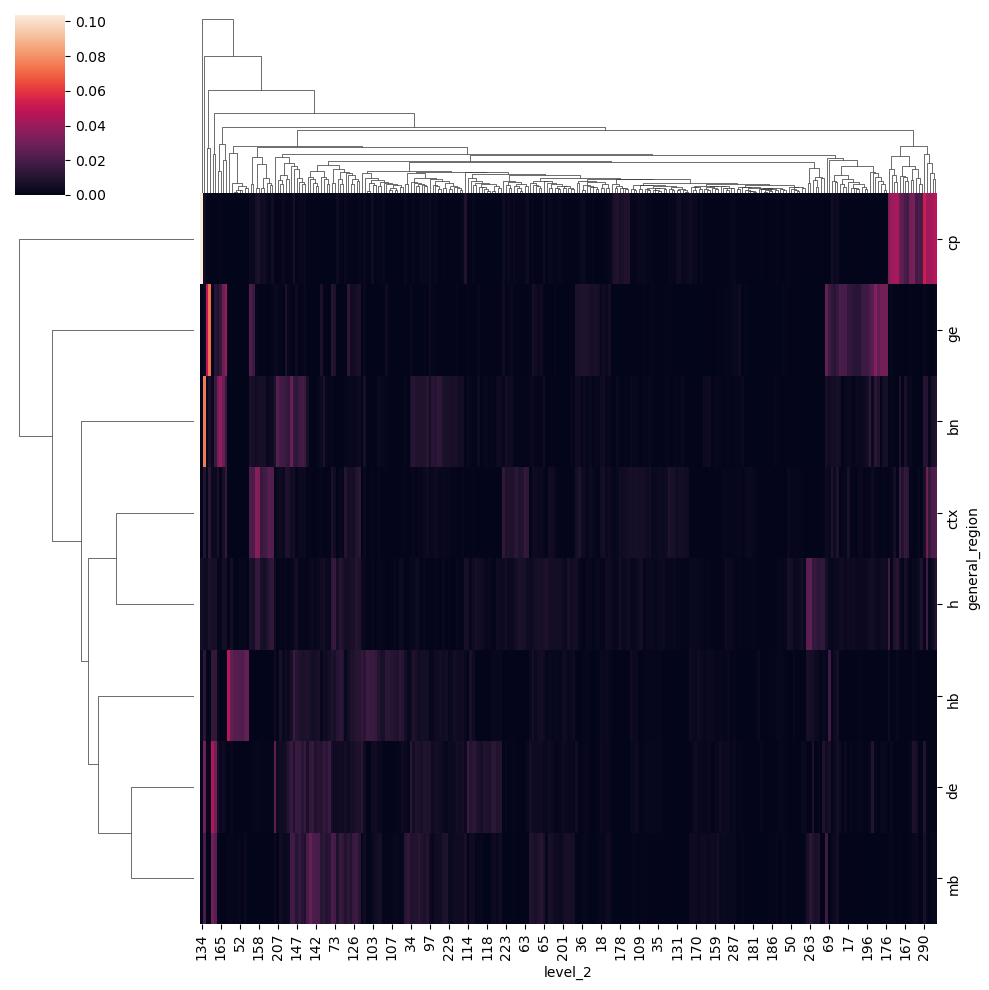

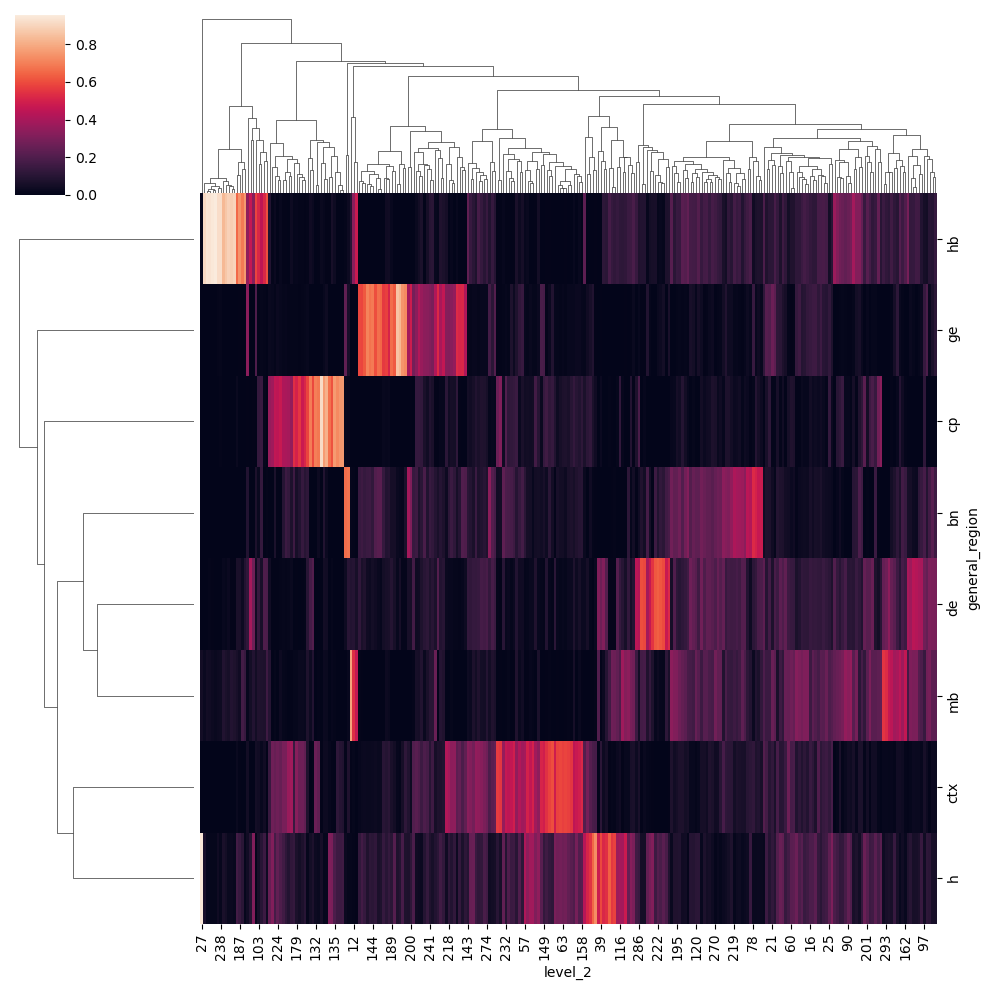

In [112]:
regs=adata.obs.groupby('general_region')['level_2'].value_counts(normalize=True).unstack()
seaborn.clustermap(regs)
regs=regs/regs.sum(0)
seaborn.clustermap(regs)


In [113]:
marker_df.loc[:,regs.index]=regs.T

In [114]:
marker_df

,marker1,marker2,juvenile_mapped,juvenile_class_mapped,bn,cp,ctx,de,ge,h,hb,mb
0,NEUROD1,GAMT,"265 PB Sst Gly-Gaba,314 CB Granule Glut,338 Ly...","26 P GABA,29 CB Glut,34 Immune,29 CB Glut,16 H...",0.000000,0.000000,0.001139,0.004943,0.002981,0.028171,0.876566,0.086201
1,DLX1,DLX2,"048 RHP-COA Ndnf Gaba,045 OB-STR-CTX Inh IMN,0...","06 CTX-CGE GABA,05 OB-IMN GABA,06 CTX-CGE GABA...",0.137984,0.002631,0.016697,0.120115,0.586806,0.124850,0.000802,0.010116
2,NEUROD2,SATB2,"027 L6b EPd Glut,017 CA3 Glut,025 CA2-FC-IG Gl...","02 NP-CT-L6b Glut,01 IT-ET Glut,01 IT-ET Glut,...",0.182839,0.119989,0.444028,0.028616,0.009063,0.196874,0.004308,0.014283
4,NEUROD2,NEUROD6,"027 L6b EPd Glut,030 L6 CT CTX Glut,025 CA2-FC...","02 NP-CT-L6b Glut,02 NP-CT-L6b Glut,01 IT-ET G...",0.062813,0.036623,0.579479,0.021249,0.014290,0.278390,0.001683,0.005473
6,LHX6,NPY,"056 Sst Chodl Gaba,075 MEA-BST Lhx6 Nr2e1 Gaba...","08 CNU-MGE GABA,11 CNU-HYa GABA,08 CNU-MGE GAB...",0.134877,0.019044,0.100902,0.048761,0.561757,0.134370,0.000290,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
295,TBR1,NXPH3,"029 L6b CTX Glut,027 L6b EPd Glut,030 L6 CT CT...","02 NP-CT-L6b Glut,02 NP-CT-L6b Glut,02 NP-CT-L...",0.030062,0.077251,0.583735,0.013425,0.009550,0.276863,0.004111,0.005003
296,ZIC1,GNG8,"314 CB Granule Glut,315 DCO UBC Glut,145 MH Ta...","29 CB Glut,29 CB Glut,17 MH-LH Glut,24 MY Glut...",0.000000,0.000000,0.001043,0.000357,0.000739,0.060599,0.908999,0.028264
297,MSX1,TTR,"321 Astroependymal NN,325 CHOR NN,329 ABC NN,3...","30 Astro-Epen,30 Astro-Epen,33 Vascular,30 Ast...",0.000000,0.018728,0.023651,0.177641,0.008465,0.180793,0.238909,0.351813
298,SATB2,NRGN,"004 L6 IT CTX Glut,020 L2/3 IT RSP Glut,017 CA...","01 IT-ET Glut,01 IT-ET Glut,01 IT-ET Glut,01 I...",0.030718,0.686144,0.237275,0.002741,0.003100,0.024986,0.004670,0.010367


In [115]:
marker_df.to_csv('/home/matthew.schmitz/mapping_labels_markers.csv')

In [116]:
marker_mins.mean(1)

0     -0.112043
1     -0.109331
2     -0.106744
4     -0.107091
6     -0.106818
         ...   
295   -0.102363
296   -0.113415
297   -0.120822
298   -0.104101
299   -0.113432
Length: 271, dtype: float64

In [117]:
z_scores = marker_mins.apply(scipy.stats.zscore)
max_zscore_columns = z_scores.idxmax(axis=1)

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/antipode/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


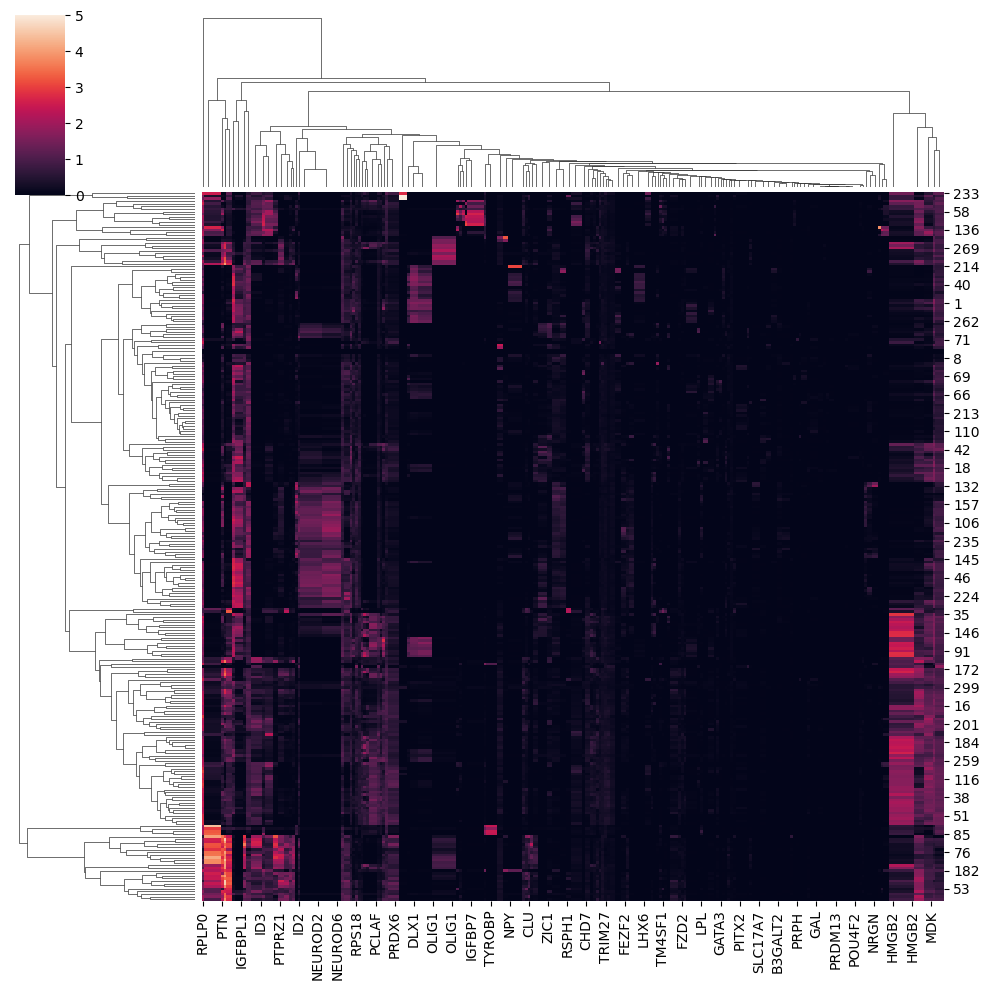

In [118]:
seaborn.clustermap(dev_mouse_means.loc[:,marker_mins.idxmax(1)])


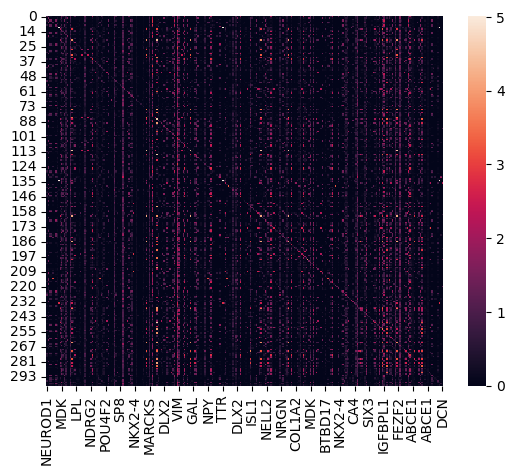

<Axes: >

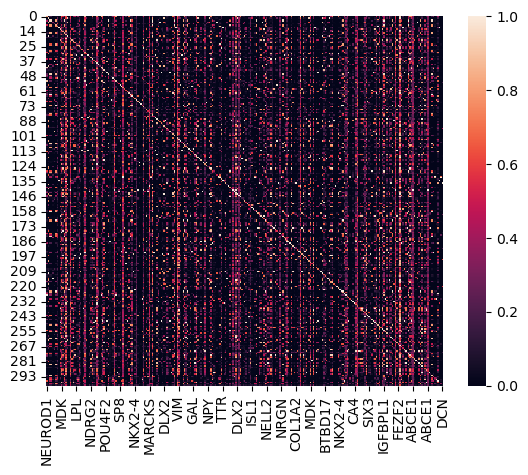

In [119]:
seaborn.heatmap(dev_mouse_means.loc[:,marker_mins.idxmax(1)])
plt.show()
seaborn.heatmap(dev_mouse_means.loc[:,marker_mins.idxmax(1)]/dev_mouse_means.loc[:,marker_mins.idxmax(1)].max(0))

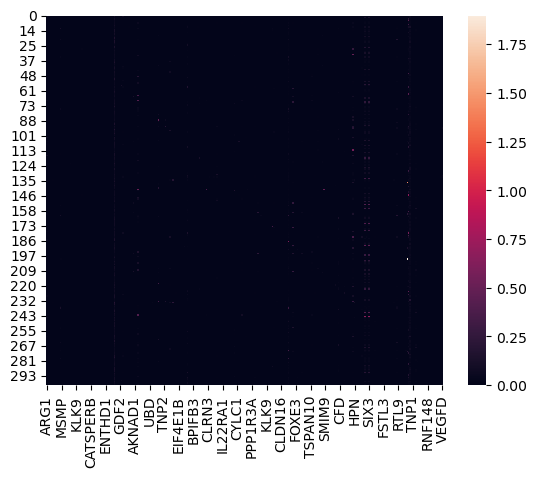

<Axes: >

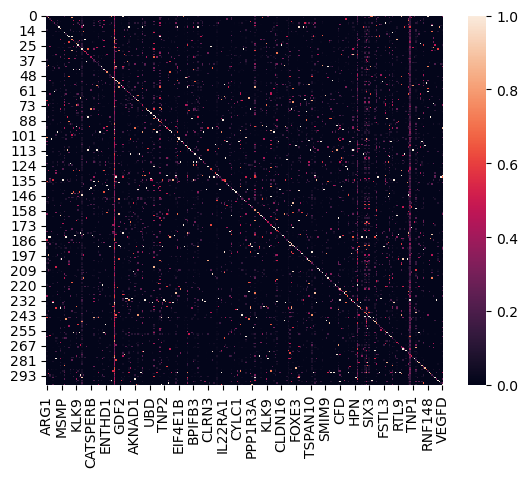

In [120]:
seaborn.heatmap(dev_mouse_means.loc[:,max_zscore_columns])
plt.show()
seaborn.heatmap(dev_mouse_means.loc[:,max_zscore_columns]/dev_mouse_means.loc[:,max_zscore_columns].max(0))

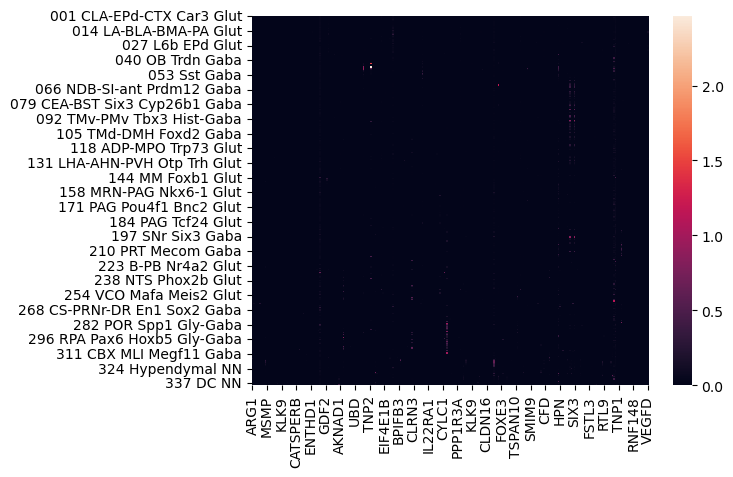

<Axes: >

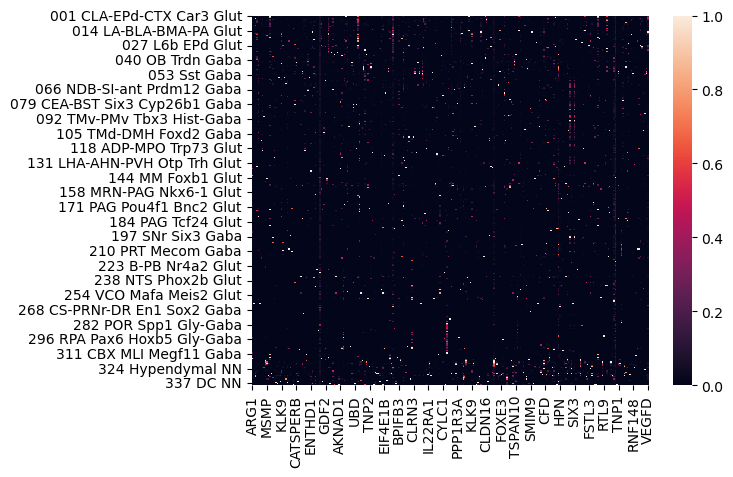

In [121]:
seaborn.heatmap(juv_mouse_means.loc[:,max_zscore_columns])
plt.show()
seaborn.heatmap(juv_mouse_means.loc[:,max_zscore_columns]/juv_mouse_means.loc[:,max_zscore_columns].max(0))

In [128]:
#juvdata[:,juvdata.var.index.isin(tf_genes['gene'])].write_h5ad(os.path.expanduser('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/extra/KDCbVelocityMouseWbAdultPresupervisionHumanOrthosTFonly.h5ad'))

In [129]:
#mini_adata=sc_analysis.select_k_cells(adata,'level_2',100000)

In [130]:
#mini_adata.obs=mini_adata.obs.drop(['clean_cellname', 'full_cellname', 'msregion'],axis=1)

In [131]:
#mini_adata.write_h5ad('/allen/programs/celltypes/workgroups/rnaseqanalysis/hct_ux3_cellxgene/anndata_080/V1Evo/mini_p4_adata.h5ad')

In [285]:
curated_class_label=pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/hct_ux3_cellxgene/anndata_080/V1Evo/mini_p4_adata_annotations/d3anno.csv',index_col=0,header=2)

In [286]:
adata.obs['curated_class_label']=curated_class_label

In [287]:
curc_dict=adata.obs.loc[~adata.obs['curated_class_label'].isna(),['level_2','curated_class_label']].groupby('level_2')['curated_class_label'].value_counts().unstack().idxmax(1).to_dict()

/scratch/fast/16874833/ipykernel_7510/4114063540.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  curc_dict=adata.obs.loc[~adata.obs['curated_class_label'].isna(),['level_2','curated_class_label']].groupby('level_2')['curated_class_label'].value_counts().unstack().idxmax(1).to_dict()


In [288]:
adata.obs['curated_class_label']=adata.obs['level_2'].replace(curc_dict)

/scratch/fast/16874833/ipykernel_7510/3492635139.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['curated_class_label']=adata.obs['level_2'].replace(curc_dict)


In [290]:
adata.obs['curated_class_label']=adata.obs['curated_class_label'].cat.reorder_categories(sorted(adata.obs['curated_class_label'].cat.categories))

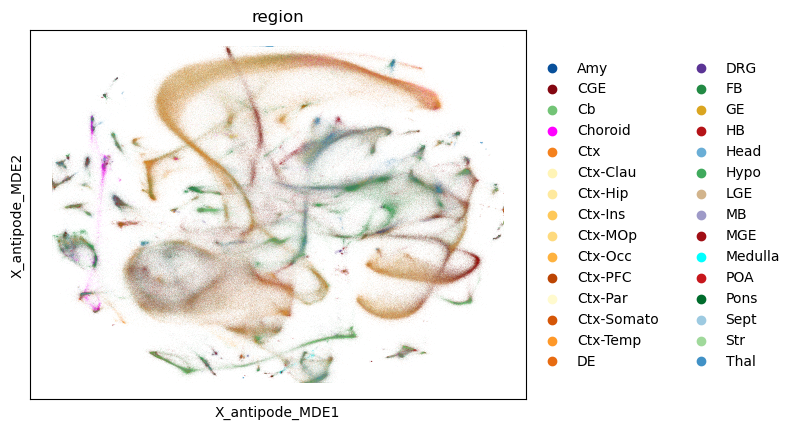

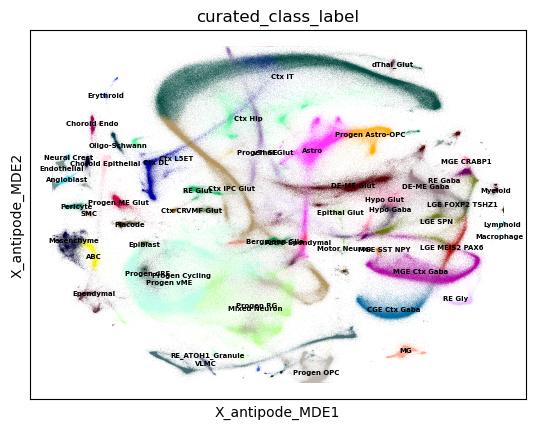

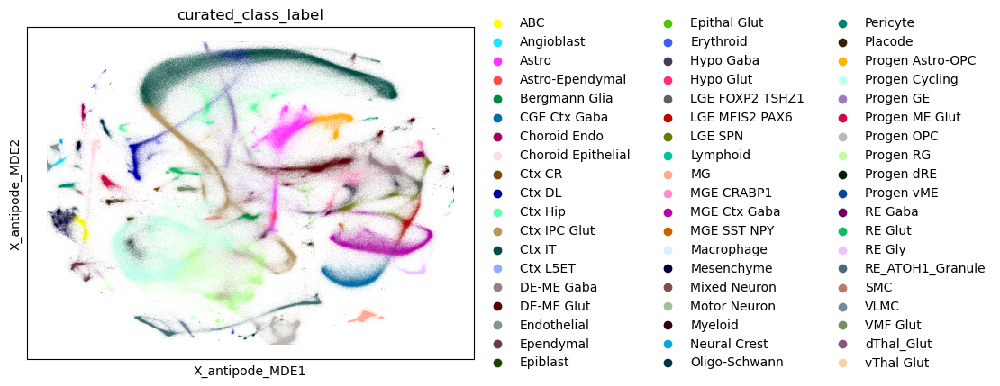

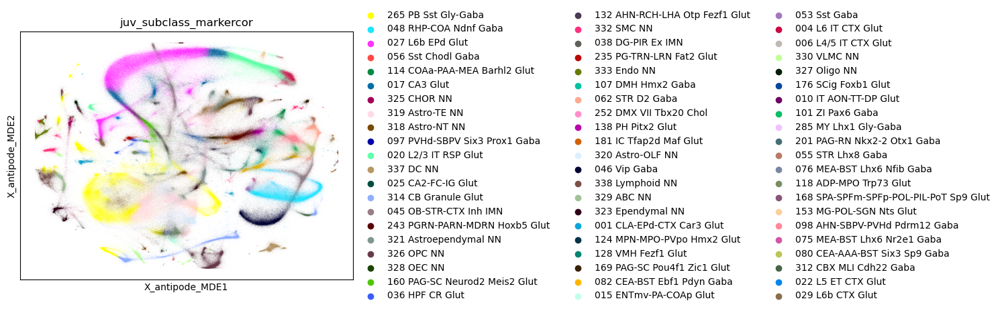

In [291]:
adata.uns['region_colors']=adata.uns['region_colors_dict'].values()
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["region"],
)

sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["curated_class_label"],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data',legend_fontsize=5
    
)
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["curated_class_label"],
    palette=sc.pl.palettes.godsnot_102
)

sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["juv_subclass_markercor"],
    palette=sc.pl.palettes.godsnot_102
)

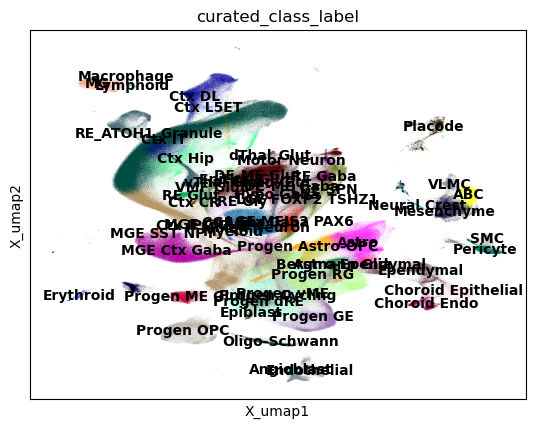

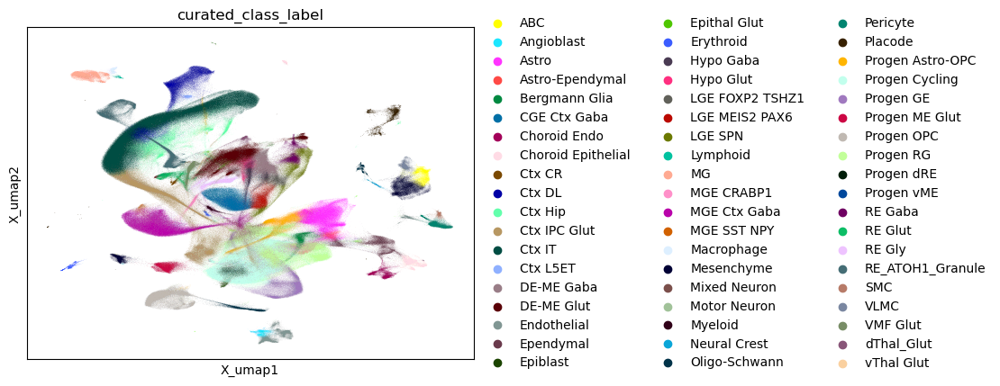

In [292]:
adata.obsm['X_umap']=np.loadtxt(os.path.join('/home/matthew.schmitz/Matthew/models/1.9.1.8.3_Dev/',"X_umap.csv"), delimiter=",")
sc.pl.embedding(
    adata,
    basis='X_umap',
    color=["curated_class_label"],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data'
)

sc.pl.embedding(
    adata,
    basis='X_umap',
    color=["curated_class_label"],
    palette=sc.pl.palettes.godsnot_102
)

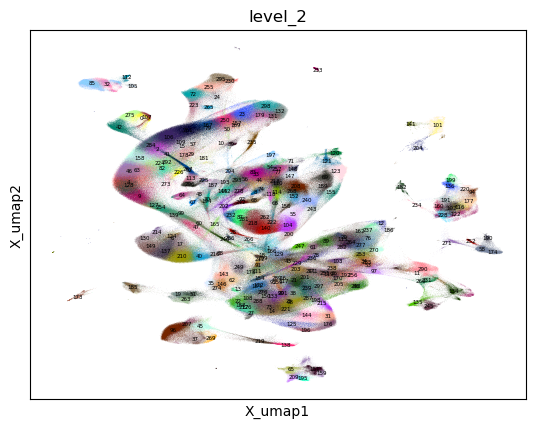

In [293]:
sc.pl.embedding(
    adata,
    basis='X_umap',
    color=["level_2"],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data',legend_fontsize=4,legend_fontweight='medium'
)


In [294]:
{x:'' for x in sorted(adata.obs['curated_class_label'].unique())}

{'ABC': '',
 'Angioblast': '',
 'Astro': '',
 'Astro-Ependymal': '',
 'Bergmann Glia': '',
 'CGE Ctx Gaba': '',
 'Choroid Endo': '',
 'Choroid Epithelial': '',
 'Ctx CR': '',
 'Ctx DL': '',
 'Ctx Hip': '',
 'Ctx IPC Glut': '',
 'Ctx IT': '',
 'Ctx L5ET': '',
 'DE-ME Gaba': '',
 'DE-ME Glut': '',
 'Endothelial': '',
 'Ependymal': '',
 'Epiblast': '',
 'Epithal Glut': '',
 'Erythroid': '',
 'Hypo Gaba': '',
 'Hypo Glut': '',
 'LGE FOXP2 TSHZ1': '',
 'LGE MEIS2 PAX6': '',
 'LGE SPN': '',
 'Lymphoid': '',
 'MG': '',
 'MGE CRABP1': '',
 'MGE Ctx Gaba': '',
 'MGE SST NPY': '',
 'Macrophage': '',
 'Mesenchyme': '',
 'Mixed Neuron': '',
 'Motor Neuron': '',
 'Myeloid': '',
 'Neural Crest': '',
 'Oligo-Schwann': '',
 'Pericyte': '',
 'Placode': '',
 'Progen Astro-OPC': '',
 'Progen Cycling': '',
 'Progen GE': '',
 'Progen ME Glut': '',
 'Progen OPC': '',
 'Progen RG': '',
 'Progen dRE': '',
 'Progen vME': '',
 'RE Gaba': '',
 'RE Glut': '',
 'RE Gly': '',
 'RE_ATOH1_Granule': '',
 'SMC': '',
 '

In [299]:
neigh_dict={'ABC': 'NN',
 'Angioblast': 'NN',
 'Astro': 'NN',
 'Astro-Ependymal': 'NN',
 'Bergmann Glia': 'NN',
 'CGE Ctx Gaba': 'T',
 'Choroid Endo': 'NN',
 'Choroid Epithelial': 'NN',
 'Ctx CR': 'T',
 'Ctx DL': 'T',
 'Ctx Hip': 'T',
 'Ctx IPC Glut': 'T',
 'Ctx IT': 'T',
 'Ctx L5ET': 'T',
 'DE-ME Gaba': 'DMR',
 'DE-ME Glut': 'DMR',
 'Endothelial': 'NN',
 'Ependymal': 'NN',
 'Epithal Glut': 'DMR',
 'Epiblast': 'O',
 'Erythroid': 'O',
 'Hypo Gaba': 'DMR',
 'Hypo Glut': 'DMR',
 'LGE SPN': 'T',
 'LGE FOXP2 TSHZ1': 'T',
 'LGE MEIS2 PAX6': 'T',
 'Lymphoid': 'O',
 'MG': 'NN',
 'MGE SST NPY': 'T',
 'MGE CRABP1': 'T',
 'MGE Ctx Gaba': 'T',
 'Macrophage': 'O',
 'Mesenchyme': 'NN',
 'Mixed Neuron': 'DMR',
 'Motor Neuron': 'DMR',
 'Myeloid': 'O',
 'Neural Crest': 'O',
 'Oligo-Schwann': 'NN',
 'Pericyte': 'NN',
 'Placode': 'O',
 'Progen Astro-OPC': 'NN',
 'Progen Cycling': 'P',
 'Progen GE': 'T',
 'Progen ME Glut': 'DMR',
 'Progen OPC': 'NN',
 'Progen RG': 'P',
 'Progen dRE': 'DMR',
 'Progen vME': 'DMR',
 'RE Gaba': 'DMR',
 'RE Glut': 'DMR',
 'RE Gly': 'DMR',
 'RE_ATOH1_Granule': 'DMR',
 'SMC': 'NN',
 'VLMC': 'NN',
 'VMF Glut': 'DMR',
 'dThal_Glut': 'DMR',
 'vThal Glut': 'DMR'}


In [300]:
adata.obs['neighborhood']=adata.obs['curated_class_label'].replace(neigh_dict)

/scratch/fast/16874833/ipykernel_7510/3537919805.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['neighborhood']=adata.obs['curated_class_label'].replace(neigh_dict)


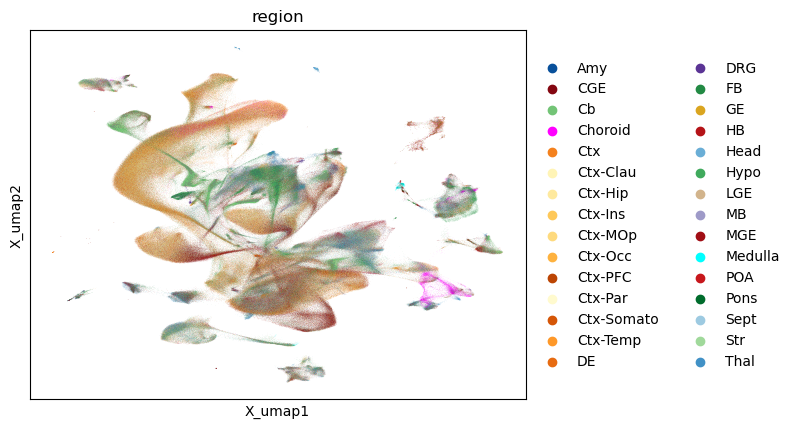

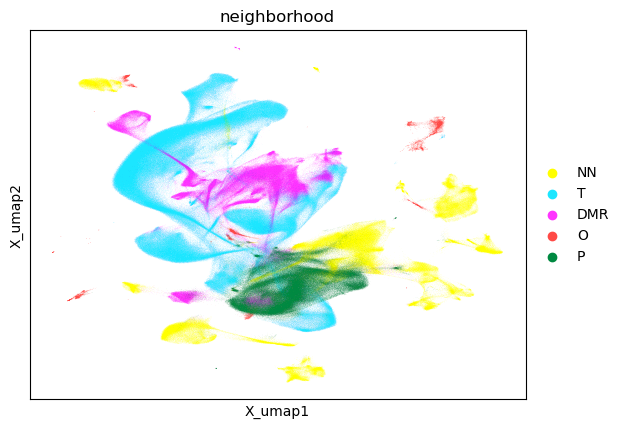

In [316]:
sc.pl.embedding(
    adata,
    basis='X_umap',
    color=["region"],
)
sc.pl.embedding(
    adata,
    basis='X_umap',
    palette=sc.pl.palettes.godsnot_102,
    color=["neighborhood"],
)

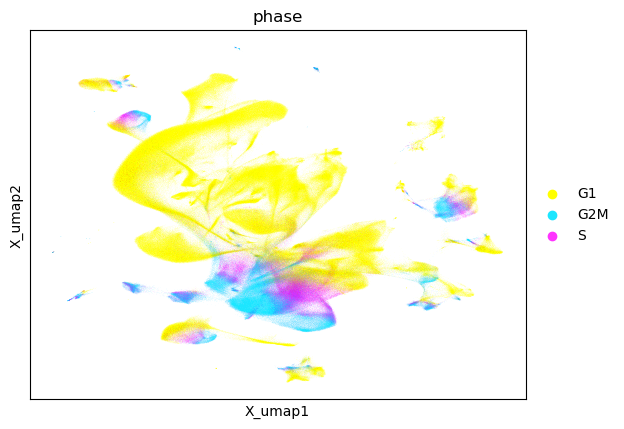

In [302]:
sc.pl.embedding(
    adata,
    basis='X_umap',
    color=["phase"],
)

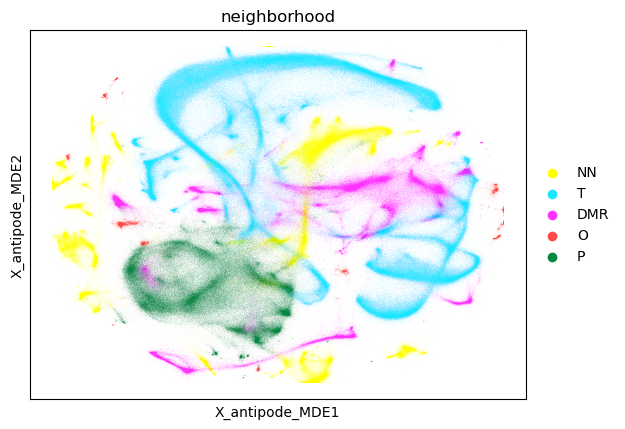

In [303]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["neighborhood"],
    palette=sc.pl.palettes.godsnot_102
)


In [318]:
#adata.obs.loc[:,['level_2','neighborhood','curated_class_label']].to_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/annotations/curated_class.txt')

In [320]:
curateds=pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/annotations/curated_class.txt',index_col=0)
adata.obs.loc[:,['level_2','neighborhood','curated_class_label']]=curateds

/scratch/fast/16874833/ipykernel_7510/758627509.py:2: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[141 141 188 ... 187  45 296]' has dtype incompatible with category, please explicitly cast to a compatible dtype first.
  adata.obs.loc[:,['level_2','neighborhood','curated_class_label']]=curateds


In [317]:
t_set=(adata.obs['general_region'].isin(['bn', 'ctx','ge'])&(adata.obs['neighborhood'].isin(['P']))) | adata.obs['neighborhood'].isin(['T'])
print(adata[t_set,:])
dmr_set=(adata.obs['general_region'].isin(['de','h', 'hb', 'mb'])&(adata.obs['neighborhood'].isin(['P']))) | adata.obs['neighborhood'].isin(['DMR'])
print(adata[dmr_set,:])
nn_set=adata.obs['neighborhood'].isin(['P','NN'])
print(adata[nn_set,:])

View of AnnData object with n_obs × n_vars = 995358 × 16738 backed at '/home/matthew.schmitz/Matthew/models/1.9.1.8.3_Dev/p4_adata.h5ad'
    obs: 'n_genes', 'batch_name', 'dataset_name', 'timepoint', 'region', 'clean_cellname', 'full_cellname', 'msregion', 'general_region', 'species', 'percent_ribo', 'n_counts', 'log10_n_counts', 'individual', 'singlet', 'doublet', 'S_score', 'G2M_score', 'phase', '_scvi_discov_ind', '_scvi_batch_ind', 'psi_0', 'psi_1', 'psi_2', 'q_score', 'level_0', 'level_1', 'level_2', 'antipode_cluster', 'Class', 'Subclass', 'ClusterName', 'linnarson_extended', 'rpca_class', 'rpca_leiden', 'rpca_class_extended', 'telencephalon', 'initial_class', 'ic_extended', 'class_label', 'supertype_label', 'subclass_label', 'juvenile_class_label', 'juvenile_supertype_label', 'juvenile_subclass_label', 'abc_subclass_markercor', 'juv_subclass_markercor', 'neighborhood', 'curated_class_label'
    var: 'n_cells', 'highly_variable', 'highly_variable_nbatches', 'highly_variable_inter